In [46]:
# Instalar la librería para análisis de sentimientos
#!pip install vaderSentiment
# Instalar la librería geoespacial
#!pip install geopandas

In [47]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="whitegrid")
import geopandas as gpd


## Cargar el dataset proporcionado y realizar un análisis exploratorio de los datos.

In [48]:
# from google.colab import files
# import io

print("Por favor, selecciona el archivo 'listings.csv' que descargaste.")
data_url =  "https://data.insideairbnb.com/argentina/ciudad-aut%C3%B3noma-de-buenos-aires/buenos-aires/2025-01-29/visualisations/"
data_base_url = "https://data.insideairbnb.com/argentina/ciudad-aut%C3%B3noma-de-buenos-aires/buenos-aires/2025-01-29/data/"

# Carga el archivo subido a un DataFrame de pandas
try:
    df = pd.read_csv(data_url + "listings.csv")

except (IndexError, KeyError):
    print("No se seleccionó ningún archivo. Por favor, ejecuta la celda de nuevo.")

Por favor, selecciona el archivo 'listings.csv' que descargaste.


In [49]:
display(df.head())
n_filas = len(df)
print(f"Filas: {n_filas}")



,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,11508,Amazing Luxurious Apt-Palermo Soho,42762,Candela,NaN,Palermo,-34.581840,-58.424150,Entire home/apt,67518.0,3,44,2025-01-26,0.29,1,300,5,NaN
1,14222,"RELAX IN HAPPY HOUSE - PALERMO, BUENOS AIRES",87710233,María,NaN,Palermo,-34.586170,-58.410360,Entire home/apt,22375.0,7,123,2025-01-18,0.80,6,44,8,NaN
2,15074,ROOM WITH RIVER SIGHT,59338,Monica,NaN,Nuñez,-34.538920,-58.465990,Private room,NaN,29,0,NaN,NaN,1,0,0,NaN
3,16695,DUPLEX LOFT 2 - SAN TELMO,64880,Elbio Mariano,NaN,Monserrat,-34.614390,-58.376110,Entire home/apt,52511.0,2,45,2019-11-30,0.27,9,365,0,NaN
4,20062,PENTHOUSE /Terrace & pool /City views /2bedrooms,75891,Sergio,NaN,Palermo,-34.581848,-58.441605,Entire home/apt,113360.0,2,330,2025-01-17,1.84,4,209,25,NaN


Filas: 35172


In [50]:

print("Por favor, selecciona el archivo 'neighbourhoods.csv'")
df_barrios_oficiales = pd.read_csv(data_url + "neighbourhoods.csv")

Por favor, selecciona el archivo 'neighbourhoods.csv'


In [51]:
# Obtener los nombres únicos de los barrios del DataFrame principal
barrios_en_listings = set(df['neighbourhood'].dropna().unique())

# Obtener los nombres de la lista oficial de barrios
barrios_oficiales = set(df_barrios_oficiales['neighbourhood'].dropna().unique())

# Comparar los dos conjuntos para encontrar diferencias
barrios_no_encontrados_en_lista_oficial = barrios_en_listings - barrios_oficiales
barrios_sin_listings = barrios_oficiales - barrios_en_listings

print(f"Total de barrios en listings: {len(barrios_en_listings)}")
print(f"Total de barrios en lista oficial: {len(barrios_oficiales)}")

if not barrios_no_encontrados_en_lista_oficial:
    print("\n✅ Todos los barrios presentes en los listings están en la lista oficial.")
else:
    print(f"\n⚠️ Alerta: Se encontraron {len(barrios_no_encontrados_en_lista_oficial)} barrios en los listings que no están en la lista oficial:")
    print(barrios_no_encontrados_en_lista_oficial)

if barrios_sin_listings:
  print(f"\nℹ️ Información: Hay {len(barrios_sin_listings)} barrios oficiales que no tienen ningún listing en el dataset.")
  # print(barrios_sin_listings) # Descomentar para ver la lista

Total de barrios en listings: 48
Total de barrios en lista oficial: 49

✅ Todos los barrios presentes en los listings están en la lista oficial.

ℹ️ Información: Hay 1 barrios oficiales que no tienen ningún listing en el dataset.


In [52]:
# Cargar el archivo geojson (subiéndolo como los otros archivos)
print("Por favor, selecciona el archivo 'neighbourhoods.geojson'")

gdf_barrios = gpd.read_file(data_url + "neighbourhoods.geojson")

Por favor, selecciona el archivo 'neighbourhoods.geojson'


In [53]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer


# Cargar el archivo reviews.csv.gz (el archivo comprimido)
print("Por favor, selecciona el archivo 'reviews.csv.gz'")

# Leer el archivo CSV comprimido directamente con pandas
# El cambio clave está en el parámetro compression='gzip'
df_reviews = pd.read_csv(data_base_url+"reviews.csv.gz",
    compression='gzip'
)


Por favor, selecciona el archivo 'reviews.csv.gz'


In [54]:
# Este comando te mostrará los nombres de todas las columnas en df_reviews
print(df_reviews.columns)

Index(['listing_id', 'id', 'date', 'reviewer_id', 'reviewer_name', 'comments'], dtype='object')


In [55]:
# Inicializar el analizador de sentimientos
analyzer = SentimentIntensityAnalyzer()

# Eliminar reseñas sin texto para evitar errores
df_reviews_cleaned = df_reviews.dropna(subset=['comments'])

# Aplicar el análisis de sentimiento a cada comentario.
# Nos interesa el score 'compound', que es un valor normalizado entre -1 (muy negativo) y 1 (muy positivo).
# Este paso puede tardar unos minutos si el archivo es grande.
df_reviews_cleaned['sentiment_score'] = df_reviews_cleaned['comments'].apply(lambda comment: analyzer.polarity_scores(str(comment))['compound'])

# Agrupar por alojamiento y calcular el sentimiento promedio
sentiment_promedio = df_reviews_cleaned.groupby('listing_id')['sentiment_score'].mean().reset_index()

# Renombrar columnas para la unión
# El ID del alojamiento en df (listings) se llama 'id' y en df_reviews se llama 'listing_id'
sentiment_promedio.rename(columns={'listing_id': 'id'}, inplace=True)

# Unir el score de sentimiento al DataFrame principal (df)
df = pd.merge(df, sentiment_promedio, on='id', how='left')

print("Se ha añadido la columna 'sentiment_score' al DataFrame principal.")
display(df[['id', 'name', 'sentiment_score']].head())

Se ha añadido la columna 'sentiment_score' al DataFrame principal.


/tmp/ipykernel_7458/3074460714.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_reviews_cleaned['sentiment_score'] = df_reviews_cleaned['comments'].apply(lambda comment: analyzer.polarity_scores(str(comment))['compound'])


,id,name,sentiment_score
0,11508,Amazing Luxurious Apt-Palermo Soho,0.639836
1,14222,"RELAX IN HAPPY HOUSE - PALERMO, BUENOS AIRES",0.633446
2,15074,ROOM WITH RIVER SIGHT,NaN
3,16695,DUPLEX LOFT 2 - SAN TELMO,0.360856
4,20062,PENTHOUSE /Terrace & pool /City views /2bedrooms,0.670835


In [56]:


# --- 1. Carga y Preparación de calendar.csv.gz ---
print("Por favor, selecciona el archivo 'calendar.csv.gz'")
# uploaded_calendar = files.upload()

try:
    # Se lee el archivo comprimido directamente
    df_calendar = pd.read_csv(data_base_url+"calendar.csv.gz", compression='gzip')
    # print(f"\n✅ Archivo '{file_name_calendar}' cargado y descomprimido.")

    # --- 2. Limpieza de Datos ---
    df_calendar['date'] = pd.to_datetime(df_calendar['date'])
    df_calendar['price'] = df_calendar['price'].replace({'\$': '', ',': ''}, regex=True)
    df_calendar['price'] = pd.to_numeric(df_calendar['price'], errors='coerce')
    df_calendar['ocupado'] = (df_calendar['available'] == 'f').astype(int)
    print("✅ Limpieza de datos del calendario completada.")

    # --- 3. Ingeniería de Características ---
    # Tasa de Ocupación en los próximos 90 días
    fecha_limite = pd.to_datetime('today') + pd.Timedelta(days=90)
    df_prox_90_dias = df_calendar[df_calendar['date'] <= fecha_limite]
    tasa_ocupacion = df_prox_90_dias.groupby('listing_id')['ocupado'].mean().reset_index()
    tasa_ocupacion.rename(columns={'listing_id': 'id', 'ocupado': 'tasa_ocupacion_90d'}, inplace=True)

    # Precio Promedio del Calendario
    precio_promedio = df_calendar.groupby('listing_id')['price'].mean().reset_index()
    precio_promedio.rename(columns={'listing_id': 'id', 'price': 'precio_promedio_calendario'}, inplace=True)
    print("✅ Cálculo de nuevas características completado.")

    # --- 4. Unión con el DataFrame Principal ---
    # Asegúrate de que tu DataFrame principal se llame 'df'
    df = pd.merge(df, tasa_ocupacion, on='id', how='left')
    df = pd.merge(df, precio_promedio, on='id', how='left')
    print("✅ Unión con el DataFrame principal completada.")

except Exception as e:
    print(f"\n❌ Ocurrió un error durante el proceso: {e}")

Por favor, selecciona el archivo 'calendar.csv.gz'
✅ Limpieza de datos del calendario completada.
✅ Cálculo de nuevas características completado.
✅ Unión con el DataFrame principal completada.


## Describir las características principales del dataset, incluyendo el número de observaciones, número de variables y tipos de datos

In [57]:
print("--- Características del DataFrame Principal Enriquecido ---")
print(f"Nuevas dimensiones del DataFrame (filas, columnas): {df.shape}")
print("\nInformación detallada de las columnas, incluyendo las nuevas:")
df.info()

--- Características del DataFrame Principal Enriquecido ---
Nuevas dimensiones del DataFrame (filas, columnas): (35172, 21)

Información detallada de las columnas, incluyendo las nuevas:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35172 entries, 0 to 35171
Data columns (total 21 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              35172 non-null  int64  
 1   name                            35172 non-null  object 
 2   host_id                         35172 non-null  int64  
 3   host_name                       35166 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   35172 non-null  object 
 6   latitude                        35172 non-null  float64
 7   longitude                       35172 non-null  float64
 8   room_type                       35172 non-null  object 
 9   price                       

"El dataset principal (listings)  fue enriquecido mediante un proceso de ingeniería de características. Se incorporaron datos de fuentes adicionales, resultando en un DataFrame final con 21 variables. Entre las nuevas características añadidas se encuentran sentiment_score, que representa la percepción promedio de las reseñas, y tasa_ocupacion_90d, que estima la demanda futura del alojamiento. La información detallada  revela la presencia de valores nulos en estas nuevas columnas, producto de alojamientos sin reseñas, lo cual deberá ser tratado en la etapa de preprocesamiento.

In [58]:
print("\n--- Características de las Fuentes de Datos Adicionales ---")

# Para el calendario (suele ser el más grande)
print(f"\nDimensiones de df_calendar: {df_calendar.shape}")
# Para las reseñas
print(f"Dimensiones de df_reviews: {df_reviews.shape}")
# Para los datos geoespaciales
print(f"Dimensiones del GeoDataFrame de barrios: {gdf_barrios.shape}")


--- Características de las Fuentes de Datos Adicionales ---

Dimensiones de df_calendar: (12837777, 8)
Dimensiones de df_reviews: (985786, 6)
Dimensiones del GeoDataFrame de barrios: (49, 3)


## Identificar patrones generales y distribuciones

In [59]:
# Estadísticas descriptivas para las variables NUMÉRICAS
# Esto nos da la media, desviación estándar, percentiles, etc.
print(" Estadísticas para variables NUMÉRICAS:")
display(df.describe())

# Estadísticas para las variables CATEGÓRICAS (de texto)
# Esto nos muestra la cantidad de valores únicos, el más común y su frecuencia.
print("\n Estadísticas para variables CATEGÓRICAS:")
display(df.describe(include=['object']))

 Estadísticas para variables NUMÉRICAS:


,id,host_id,neighbourhood_group,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,sentiment_score,tasa_ocupacion_90d,precio_promedio_calendario
count,3.517200e+04,3.517200e+04,0.0,35172.000000,35172.000000,3.159800e+04,35172.000000,35172.000000,29412.000000,35172.000000,35172.000000,35172.000000,29412.000000,35172.000000,3.517200e+04
mean,7.117880e+17,2.143294e+08,NaN,-34.591554,-58.417289,9.548776e+04,6.159871,28.027579,1.325920,15.646878,206.609320,9.500625,0.193076,0.376950,1.444408e+03
std,4.840974e+17,2.027420e+08,NaN,0.018257,0.030169,1.402656e+06,26.072002,45.151666,1.336446,34.108688,126.189102,13.991379,0.235948,0.348682,3.174799e+04
min,1.150800e+04,1.342600e+04,NaN,-34.693700,-58.530890,2.600000e+02,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000,-0.991400,0.000000,0.000000e+00
25%,4.719776e+07,3.070016e+07,NaN,-34.602670,-58.437050,2.971100e+04,1.000000,2.000000,0.360000,1.000000,88.000000,0.000000,0.050933,0.051587,3.000000e+01
50%,8.875662e+17,1.421004e+08,NaN,-34.590890,-58.418914,3.990800e+04,2.000000,11.000000,0.930000,2.000000,231.000000,4.000000,0.162542,0.289683,4.000000e+01
75%,1.095206e+18,4.298024e+08,NaN,-34.581047,-58.392114,5.776200e+04,4.000000,36.000000,1.910000,12.000000,333.000000,13.000000,0.305862,0.666667,6.100000e+01
max,1.344330e+18,6.754917e+08,NaN,-34.534980,-58.355403,1.050217e+08,1000.000000,992.000000,26.080000,222.000000,365.000000,340.000000,0.998100,1.000000,4.500000e+06



 Estadísticas para variables CATEGÓRICAS:


,name,host_name,neighbourhood,room_type,last_review,license
count,35172,35166,35172,35172,29412,390
unique,32872,4344,48,4,1757,365
top,Departamento en Buenos Aires,Federico,Palermo,Entire home/apt,2025-01-26,RL-2021-14800886
freq,98,533,11410,32083,598,8


## Identificar errores, outliers y valores faltantes

--- VALORES FALTANTES ---
Cantidad de valores faltantes por columna (solo se muestran las que tienen):
neighbourhood_group    35172
license                34782
last_review             5760
reviews_per_month       5760
sentiment_score         5760
price                   3574
host_name                  6
dtype: int64


--- DETECCIÓN VISUAL DE OUTLIERS ---


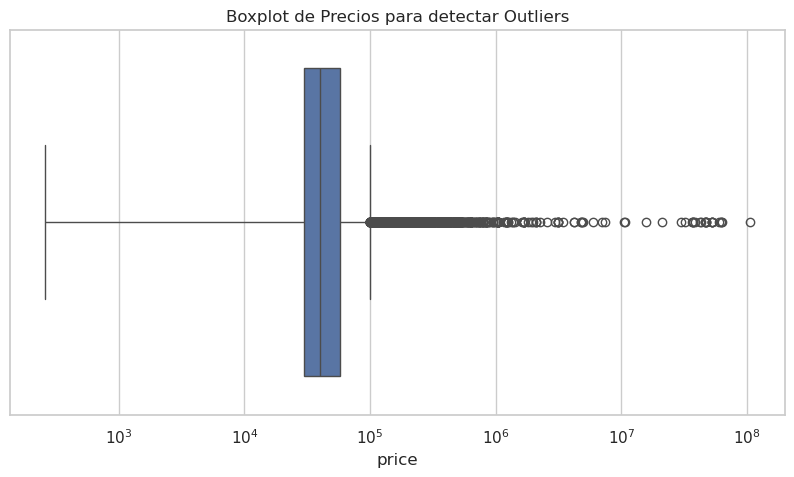

--- POSIBLES ERRORES EN CATEGORÍAS ---
Valores únicos en 'room_type': ['Entire home/apt' 'Private room' 'Hotel room' 'Shared room']


In [60]:
import seaborn as sns
import matplotlib.pyplot as plt

# --- 4.1 Valores Faltantes ---
print("--- VALORES FALTANTES ---")
missing_values = df.isnull().sum()
print("Cantidad de valores faltantes por columna (solo se muestran las que tienen):")
print(missing_values[missing_values > 0].sort_values(ascending=False))
print("\n")


# --- 4.2 Outliers (Anomalías) ---
print("--- DETECCIÓN VISUAL DE OUTLIERS ---")
# Un boxplot es ideal para ver outliers en variables numéricas como el precio.
plt.figure(figsize=(10, 5))
sns.boxplot(x=df['price'])
plt.title('Boxplot de Precios para detectar Outliers')
plt.xscale('log') # Usamos escala logarítmica para manejar la gran dispersión de precios
plt.show()


# --- 4.3 Errores de tipeo/categorías ---
print("--- POSIBLES ERRORES EN CATEGORÍAS ---")
# Revisamos los valores únicos de una columna categórica para ver si hay errores.
print(f"Valores únicos en 'room_type': {df['room_type'].unique()}")

Este gráfico de caja (boxplot) ilustra la distribución de la variable price. Se utilizó una escala logarítmica en el eje X para poder visualizar adecuadamente la estructura de los datos debido a su amplio rango.

Observaciones:

Concentración de Datos: El cuerpo principal de la distribución, representado por el rango intercuartílico (la caja azul), es relativamente compacto. Esto indica que el 50% central de los precios de los alojamientos se encuentra dentro de un rango bien definido.

Mediana: La mediana se sitúa aproximadamente en los $40,000 - $50,000, indicando el punto central de la distribución de precios.

Valores Atípicos (Outliers): Se observa una cantidad muy significativa de valores atípicos en el extremo superior de la distribución. Estos puntos se extienden considerablemente hacia la derecha, alcanzando valores de hasta 10
8
 .

Interpretación y Conclusiones:

La distribución de precios presenta un fuerte sesgo positivo (a la derecha). La presencia masiva de outliers sugiere dos posibilidades principales: (a) la existencia de errores en la carga de datos (e.g., precios en otra moneda) o (b) la presencia de un segmento de mercado de nicho correspondiente a propiedades de lujo con precios muy por encima de la norma.

Desde la perspectiva del modelado predictivo, estos valores atípicos pueden impactar negativamente el rendimiento de algoritmos sensibles a la escala y la distribución, como la regresión lineal. Por lo tanto, se considera una práctica necesaria el tratamiento de estos outliers en la etapa de preprocesamiento, ya sea mediante filtrado, transformación (e.g., logarítmica) o técnicas de capping.

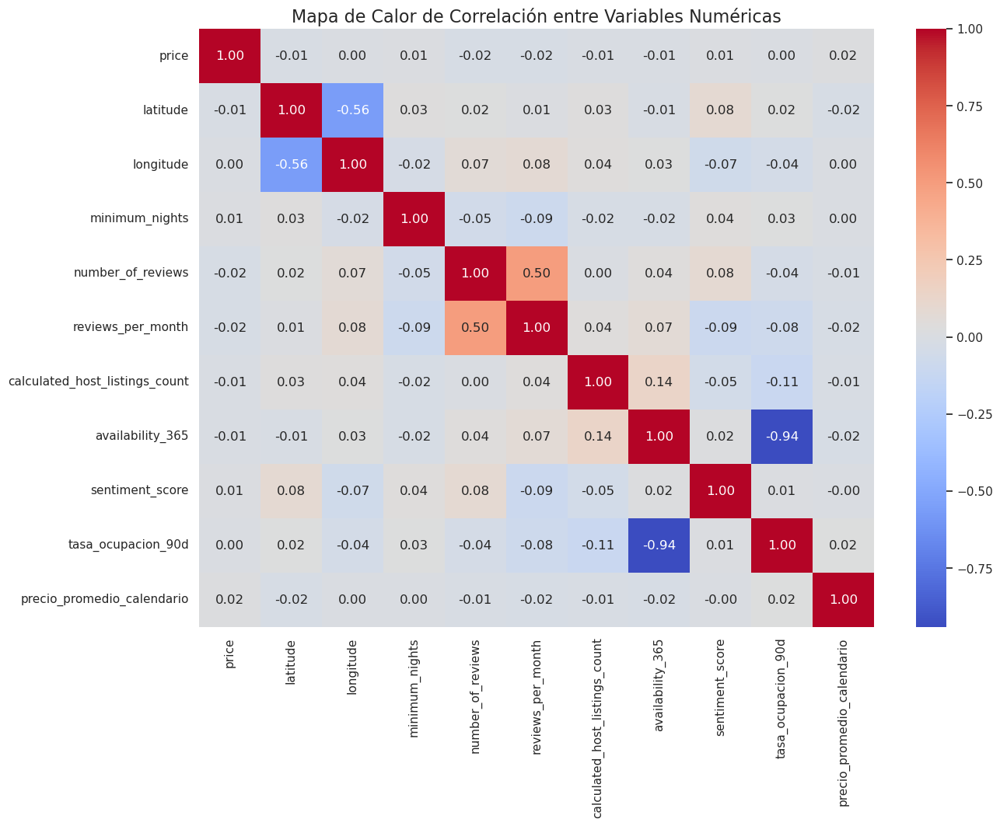

In [61]:

# 1. Seleccionar las columnas numéricas de interés para el análisis de correlación
columnas_numericas = [
    'price',
    'latitude',
    'longitude',
    'minimum_nights',
    'number_of_reviews',
    'reviews_per_month',
    'calculated_host_listings_count',
    'availability_365',
    'sentiment_score',
    'tasa_ocupacion_90d',
    'precio_promedio_calendario'
]

# Crear un nuevo DataFrame solo con estas columnas
df_numeric = df[columnas_numericas]

# 2. Calcular la matriz de correlación
matriz_correlacion = df_numeric.corr()

# 3. Crear el mapa de calor para visualizar la matriz
plt.figure(figsize=(14, 10))
sns.heatmap(matriz_correlacion,
            annot=True,      # Muestra los valores numéricos en cada celda
            cmap='coolwarm',   # Paleta de colores (rojo para positivo, azul para negativo)
            fmt=".2f")       # Formatea los números a dos decimales

plt.title('Mapa de Calor de Correlación entre Variables Numéricas', fontsize=16)
plt.show()

Conclusiones del Mapa de Calor de Correlación

El mapa de calor se generó para cuantificar la **relación lineal** entre las principales variables numéricas del conjunto de datos enriquecido. El análisis de la matriz de correlación revela varios puntos clave:

* **Ausencia de Correlaciones Fuertes con el Precio:** El hallazgo más significativo es que la variable `price` **no muestra una correlación lineal fuerte** con ninguna otra variable numérica analizada. Todos los coeficientes de correlación con `price` son muy cercanos a cero (entre -0.02 y 0.02). Esto sugiere que un modelo de regresión lineal simple, basado únicamente en estas variables, tendría un bajo poder predictivo. La determinación del precio parece depender en mayor medida de variables categóricas (como `neighbourhood` y `room_type`) o de relaciones no lineales que este análisis no captura.

* **Validación de la Característica de Ocupación:** Se observa una **correlación negativa casi perfecta (-0.94)** entre `availability_365` (días disponibles al año) y la variable de ingeniería `tasa_ocupacion_90d` (tasa de ocupación en 90 días). Este resultado es esperado y actúa como una validación de la lógica utilizada para crear la nueva característica, confirmando que una mayor disponibilidad implica una menor tasa de ocupación.

* **Correlaciones Estructurales y Geográficas:** Existen correlaciones moderadas que reflejan relaciones lógicas o estructurales en los datos:
    * La correlación positiva entre `number_of_reviews` y `reviews_per_month` (0.50) es autoevidente, ya que una variable deriva de la otra.
    * La correlación negativa entre `latitude` y `longitude` (-0.56) es un artefacto de la disposición geográfica de la grilla de la ciudad de Buenos Aires y no representa una relación económica o de mercado.

En conclusión, el mapa de calor indica que las relaciones lineales entre la mayoría de las variables numéricas son débiles. El hallazgo principal es la falta de predictores numéricos lineales para el `price`, lo que subraya la **importancia fundamental de las variables categóricas** en el modelo predictivo y la posible necesidad de utilizar algoritmos más complejos que puedan capturar interacciones no lineales en el TP2.

/tmp/ipykernel_7458/444034427.py:10: FutureWarning: The provided callable <function mean at 0x733c003b3e20> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  tabla_pivote = pd.pivot_table(df_top_barrios,


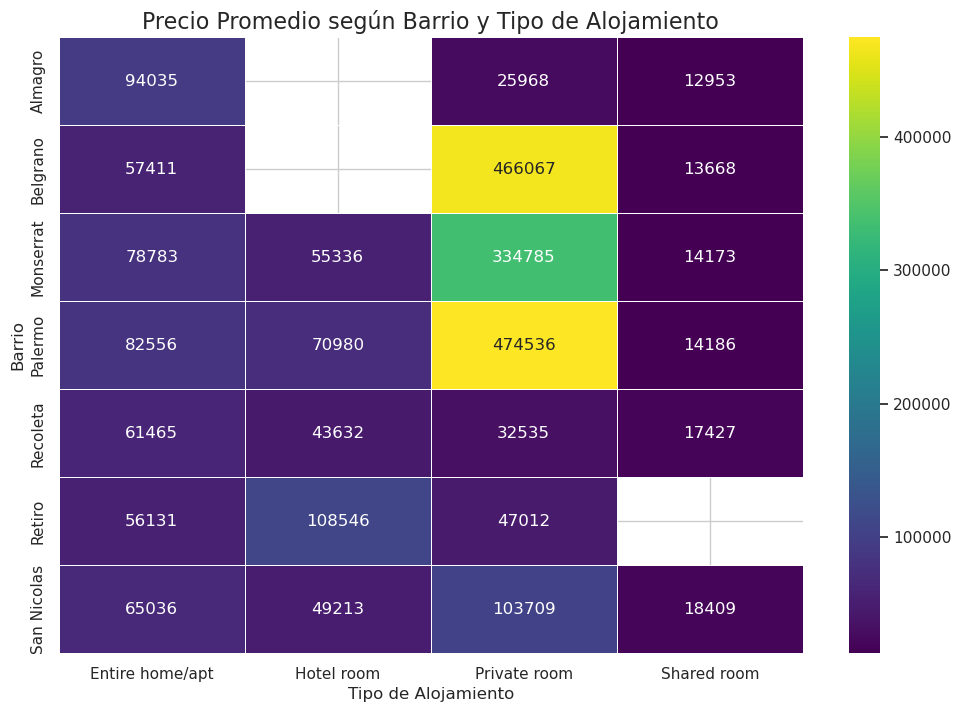

In [62]:

# 1. Seleccionar los barrios y tipos de habitación de interés.
#    Usamos los 7 barrios con más ofertas para mantener el gráfico legible.
top_barrios = df['neighbourhood'].value_counts().nlargest(7).index
df_top_barrios = df[df['neighbourhood'].isin(top_barrios)]

# 2. Crear la tabla pivote.
#    - Filas (index): Serán los barrios.
#    - Columnas: Serán los tipos de alojamiento.
#    - Valores: Serán el precio promedio para cada combinación.
tabla_pivote = pd.pivot_table(df_top_barrios,
                              values='price',
                              index='neighbourhood',
                              columns='room_type',
                              aggfunc=np.mean) # Usamos la media como función de agregación

# 3. Crear el mapa de calor a partir de la tabla pivote
plt.figure(figsize=(12, 8))
sns.heatmap(tabla_pivote,
            annot=True,      # Muestra los valores numéricos
            fmt=".0f",       # Formatea los números como enteros (sin decimales)
            cmap='viridis',  # Paleta de colores
            linewidths=.5)

plt.title('Precio Promedio según Barrio y Tipo de Alojamiento', fontsize=16)
plt.xlabel('Tipo de Alojamiento', fontsize=12)
plt.ylabel('Barrio', fontsize=12)
plt.show()

Conclusiones del Mapa de Calor sobre Tabla Pivote

Este mapa de calor visualiza la interacción entre las variables categóricas `neighbourhood` y `room_type` y su efecto sobre el `price` promedio. El análisis revela lo siguiente:

* **Impacto Significativo de Outliers en la Media:** El hallazgo más llamativo es el precio promedio anómalamente alto para la categoría `Private room` en los barrios de Palermo (474,536) y Belgrano (466,067). Este resultado contraintuitivo no sugiere que las habitaciones privadas sean intrínsecamente más caras, sino que la **media está siendo fuertemente distorsionada por la presencia de valores atípicos** extremos dentro de esa subcategoría. Esto subraya la importancia de un tratamiento de outliers robusto antes de realizar agregaciones estadísticas.

* **Confirmación de Jerarquías de Precio:** Excluyendo la anomalía mencionada, el gráfico confirma patrones esperados. La categoría `Shared room` presenta consistentemente los precios promedio más bajos. Los alojamientos de tipo `Entire home/apt` y `Hotel room` compiten por los precios más altos, dependiendo del barrio. Por ejemplo, `Hotel room` en Retiro (108,546) muestra un precio promedio superior al de `Entire home/apt` en el mismo barrio (56,131).

* **Especialización del Mercado por Zona:** La ausencia de datos en varias celdas (mostradas en blanco) indica una especialización del mercado. Por ejemplo, la falta de `Hotel room` en barrios como Almagro, Belgrano y Recoleta sugiere que la oferta de este tipo de alojamiento se concentra en otras zonas más céntricas o comerciales como Retiro y San Nicolas.

En conclusión, si bien este gráfico es potente para analizar interacciones, también demuestra ser muy sensible a los valores atípicos. Para un análisis más representativo del precio "típico" en cada cruce, sería recomendable utilizar la **mediana** en lugar de la media como función de agregación en la tabla pivote.

/tmp/ipykernel_7458/1494991494.py:6: FutureWarning: The provided callable <function median at 0x733c002cdf80> is currently using DataFrameGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.
  tabla_pivote_medianas = pd.pivot_table(df_top_barrios,


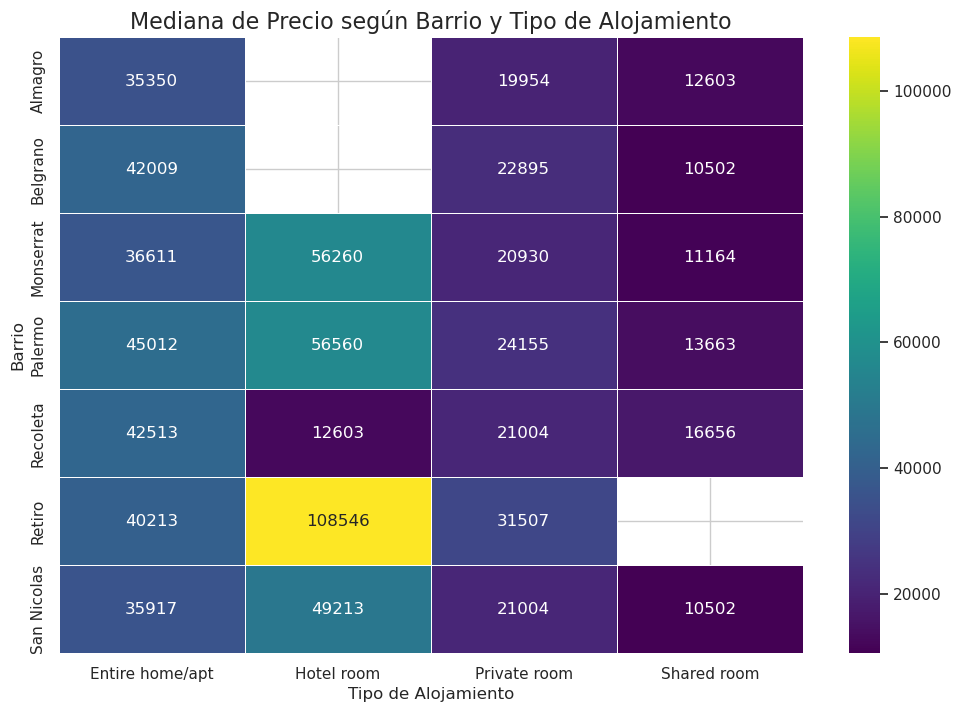

In [63]:

# 1. Seleccionar los barrios de interés (puedes usar los mismos que antes)
top_barrios = df['neighbourhood'].value_counts().nlargest(7).index
df_top_barrios = df[df['neighbourhood'].isin(top_barrios)]

# 2. Crear la tabla pivote usando la MEDIANA como función de agregación
tabla_pivote_medianas = pd.pivot_table(df_top_barrios,
                                       values='price',
                                       index='neighbourhood',
                                       columns='room_type',
                                       aggfunc=np.median) # <--- CAMBIO CLAVE AQUÍ

# 3. Crear el mapa de calor a partir de la tabla pivote de medianas
plt.figure(figsize=(12, 8))
sns.heatmap(tabla_pivote_medianas,
            annot=True,
            fmt=".0f",
            cmap='viridis',
            linewidths=.5)

plt.title('Mediana de Precio según Barrio y Tipo de Alojamiento', fontsize=16)
plt.xlabel('Tipo de Alojamiento', fontsize=12)
plt.ylabel('Barrio', fontsize=12)
plt.show()

Conclusiones del Mapa de Calor de Medianas de Precio

Este mapa de calor, que utiliza la **mediana** como medida de agregación, ofrece una visión robusta y precisa de la estructura de precios, neutralizando el efecto distorsionador de los valores atípicos extremos que afectaban el análisis anterior basado en la media.

* **Corrección de Anomalías:** El uso de la mediana ha corregido exitosamente las distorsiones observadas previamente. Los precios para la categoría `Private room` ahora se sitúan en un rango lógico y considerablemente más bajo que los de `Entire home/apt` en los mismos barrios (e.g., en Palermo,   24,155 vs. 45,012), demostrando que el análisis previo basado en la media era engañoso.

* **Identificación del Nicho de Mayor Valor:** El nuevo mapa revela que la combinación con el precio mediano más elevado corresponde a la categoría `Hotel room` en el barrio de **Retiro** (108,546). Esto sugiere que la oferta de hoteles de mayor gama listados en la plataforma se concentra en dicha zona.

* **Jerarquía de Precios Consistente:** Se confirma una **jerarquía de precios clara y consistente** dentro de cada barrio. En general, el precio mediano sigue el orden ascendente: `Shared room` < `Private room` < `Entire home/apt`. Las habitaciones de hotel (`Hotel room`) tienden a tener los precios medianos más altos, compitiendo o superando a los de los alojamientos enteros.

* **Comparación Representativa entre Barrios:** Esta visualización permite una comparación más justa del costo "típico" entre barrios. Se puede afirmar, por ejemplo, que el precio mediano para un `Entire home/apt` es más alto en **Palermo** (45,012) y **Recoleta** (42,513) que en barrios como **Almagro** (35,350).

En conclusión, este mapa de calor de medianas es una herramienta de análisis superior para este dataset. Ofrece una representación fiel de la estructura de precios, validando que el costo de un alojamiento es una función compleja de la interacción entre su ubicación geográfica y su tipología.

## Aplicación de técnicas de visualización

## 1. ¿Cuáles son los barrios con más ofertas?

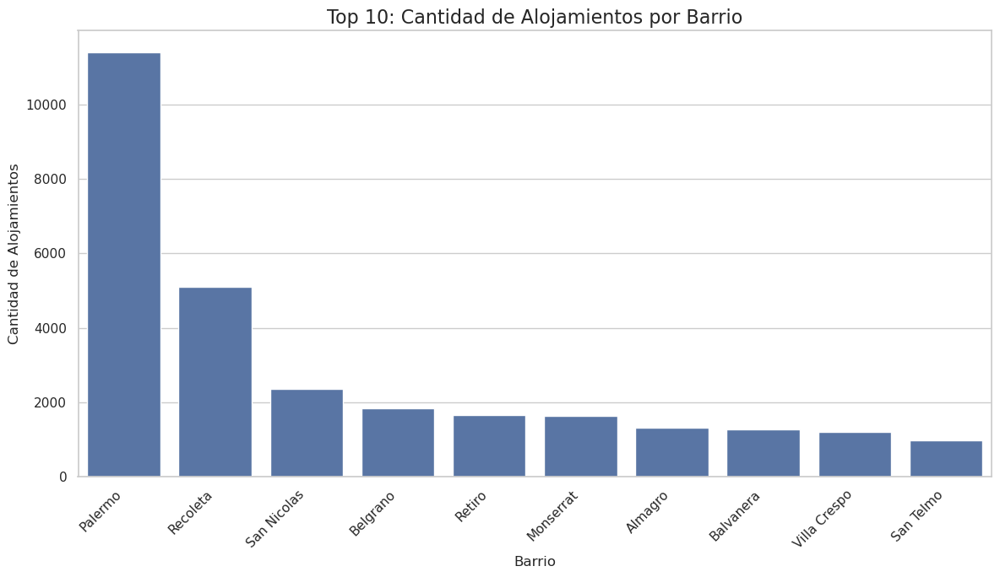

In [64]:

# Para esta visualización, es útil ver los barrios con más ofertas.
# Vamos a tomar el top 10 para que el gráfico sea legible.
top_10_neighbourhoods = df['neighbourhood'].value_counts().nlargest(10)

plt.figure(figsize=(12, 7))
sns.barplot(x=top_10_neighbourhoods.index, y=top_10_neighbourhoods.values)

plt.title('Top 10: Cantidad de Alojamientos por Barrio', fontsize=16)
plt.xlabel('Barrio', fontsize=12)
plt.ylabel('Cantidad de Alojamientos', fontsize=12)
plt.xticks(rotation=45, ha='right') # Rotamos las etiquetas para que no se superpongan
plt.tight_layout() # Ajusta el gráfico para que todo encaje
plt.show()

Este gráfico de barras presenta los 10 barrios con la mayor cantidad de alojamientos listados en la plataforma.

Observaciones:

Dominancia de Palermo: Existe una dominancia abrumadora del barrio de Palermo, que cuenta con más de 10,000 alojamientos, una cifra que supera en más del doble al segundo lugar.

Jerarquía de Barrios: Se evidencia una clara jerarquía en la distribución. Recoleta ocupa el segundo lugar con aproximadamente 5,000 listados. Un tercer grupo, que incluye barrios como San Nicolas, Belgrano y Retiro, presenta una oferta considerable pero significativamente menor.

Concentración del Mercado: La oferta está altamente concentrada. Los 10 barrios mostrados aglutinan una porción muy sustancial del total de alojamientos disponibles en la ciudad.

Interpretación y Conclusiones:

La concentración de la oferta sugiere que el mercado de alquileres temporales en Buenos Aires se centra en un número limitado de barrios, que probablemente se correlacionan con los principales polos turísticos, comerciales y gastronómicos.

Para el problema de Machine Learning propuesto, la variable categórica neighbourhood se perfila como un predictor de alta importancia. La ubicación de una propiedad, especialmente si se encuentra en Palermo, es un factor que probablemente influye de manera decisiva en su precio. De cara al TP2, una estrategia de ingeniería de características (feature engineering) a considerar sería la agrupación de barrios en "tiers" o categorías basadas en su volumen de oferta, lo que podría simplificar el modelo y capturar de manera más efectiva la estructura del mercado.

## 2. ¿Cómo se distribuyen los precios?

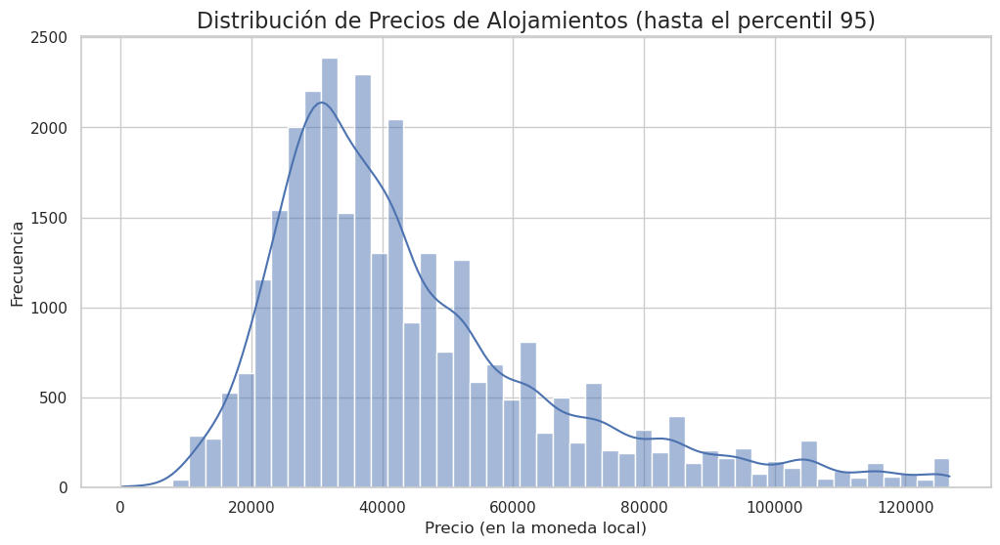

In [65]:
# Los precios tienen outliers muy altos que distorsionan el gráfico.
# Filtremos los datos para visualizar la distribución principal.
# Usaremos el percentil 95 para cortar los precios más extremos.
price_limit = df['price'].quantile(0.95)
df_filtered = df[df['price'] < price_limit]

plt.figure(figsize=(12, 6))
sns.histplot(df_filtered['price'], bins=50, kde=True) # kde traza una línea de densidad

plt.title('Distribución de Precios de Alojamientos (hasta el percentil 95)', fontsize=16)
plt.xlabel('Precio (en la moneda local)', fontsize=12)
plt.ylabel('Frecuencia', fontsize=12)
plt.show()

Análisis del Gráfico 3: Histograma de Distribución de Precios
El histograma presenta la distribución de frecuencias de la variable price. Es importante destacar que, para esta visualización, los datos han sido filtrados para incluir únicamente los valores por debajo del percentil 95. Esta acción se realizó para mitigar el efecto de los outliers extremos y poder así analizar la estructura del cuerpo principal de la distribución.

Observaciones:

Asimetría Positiva: La distribución es asimétrica y presenta un claro sesgo positivo (hacia la derecha). Esto se evidencia en la "cola" de la distribución, que se extiende mucho más hacia los precios altos en comparación con la cola izquierda.

Moda Principal: El pico de mayor frecuencia (la moda) se localiza en el rango de precios entre 30,000 y 40,000. Esto indica que esta es la franja de precios más común para los alojamientos en la plataforma.

Modas Secundarias: La curva de densidad de probabilidad (KDE), que suaviza el histograma, sugiere la posible existencia de picos de frecuencia menores, o modas secundarias, alrededor de los 80,000 y 100,000.

Interpretación y Conclusiones:

El sesgo positivo es una característica común en variables económicas como el precio y confirma que la mayoría de la oferta de alojamientos se concentra en los rangos de precios más accesibles. A medida que el precio aumenta, la cantidad de propiedades disponibles disminuye progresivamente.

La moda principal, en torno a los $30-40k, puede interpretarse como el punto de precio más competitivo del mercado. Los picos secundarios podrían reflejar la existencia de sub-mercados dentro de la oferta general, como alojamientos de mayor tamaño, con mejores servicios, o ubicados en zonas premium que, sin embargo, no llegan a ser considerados outliers extremos.

Finalmente, la naturaleza no normal de esta distribución refuerza la conclusión de que la mediana es un estadístico de tendencia central más robusto y representativo que la media para la variable price, ya que esta última se vería artificialmente elevada por la cola derecha de la distribución.

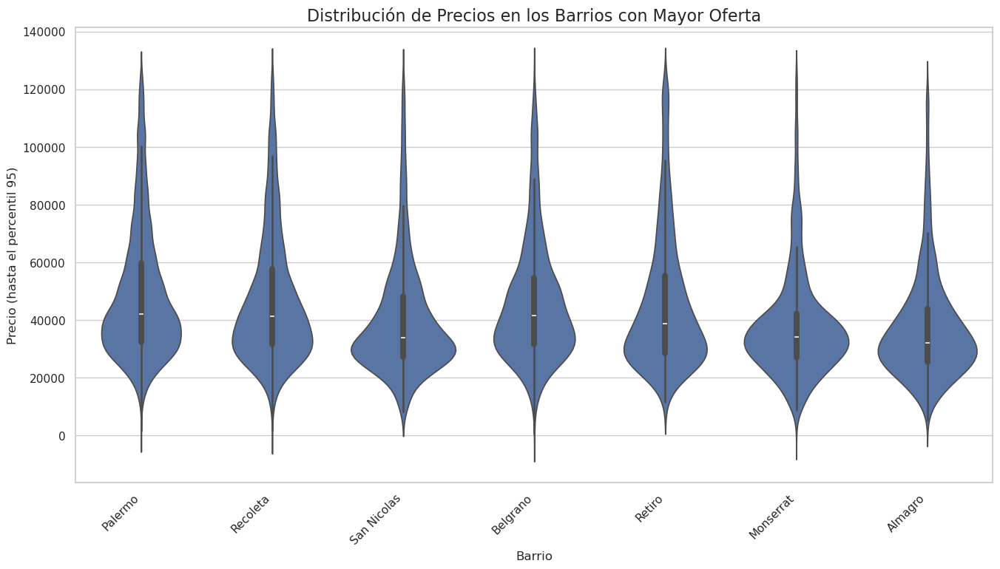

In [66]:


# 1. Identificar el top 7 de barrios con más alojamientos para que el gráfico sea legible.
top_barrios = df['neighbourhood'].value_counts().nlargest(7).index

# 2. Filtrar el DataFrame para incluir solo esos barrios
df_top_barrios = df[df['neighbourhood'].isin(top_barrios)]

# 3. Filtrar outliers de precio para una mejor visualización de las distribuciones
price_limit = df_top_barrios['price'].quantile(0.95)
df_filtered_barrios = df_top_barrios[df_top_barrios['price'] < price_limit]

# 4. Crear el gráfico de violín
plt.figure(figsize=(16, 8))
sns.violinplot(x='neighbourhood', y='price', data=df_filtered_barrios, order=top_barrios)

plt.title('Distribución de Precios en los Barrios con Mayor Oferta', fontsize=16)
plt.xlabel('Barrio', fontsize=12)
plt.ylabel('Precio (hasta el percentil 95)', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.show()

Conclusiones del Gráfico de Violín por Barrio

El gráfico de violín proporciona un análisis detallado y comparativo de la estructura de precios en los siete barrios con mayor oferta de alojamientos. A partir de esta visualización se extraen las siguientes conclusiones:

* **Confirmación de la Jerarquía de Precios:** El gráfico confirma visualmente la existencia de distintos niveles de precios entre los barrios. **Palermo**, **Recoleta**, **Belgrano** y **Retiro** presentan medianas de precios (el punto blanco dentro de cada violín) notablemente más altas en comparación con **San Nicolas**, **Monserrat** y **Almagro**. Esto segmenta el mercado en un clúster de barrios premium y otro de alternativas más económicas.

* **Estructura de Distribución Común:** A pesar de las diferencias en el nivel de precios, todos los barrios analizados comparten una forma de distribución similar: son "anchos" en la parte inferior y se estrechan hacia la parte superior. Esto indica que, incluso en los barrios más caros, la **mayor densidad de alojamientos se concentra en el rango de precios más bajo** dentro de ese mismo barrio.

* **Variabilidad Intra-Barrio:** La forma de los violines también revela la variabilidad de precios dentro de cada barrio. **Palermo** y **Recoleta** muestran "colas" superiores largas, lo que significa que, aunque tienen muchos alojamientos en la franja común, también poseen una oferta significativa de propiedades a precios muy superiores. En contraste, barrios como **Almagro** presentan una distribución más concentrada, sugiriendo un mercado más homogéneo.

## 3. ¿Cómo varían los precios según el tipo de alojamiento?

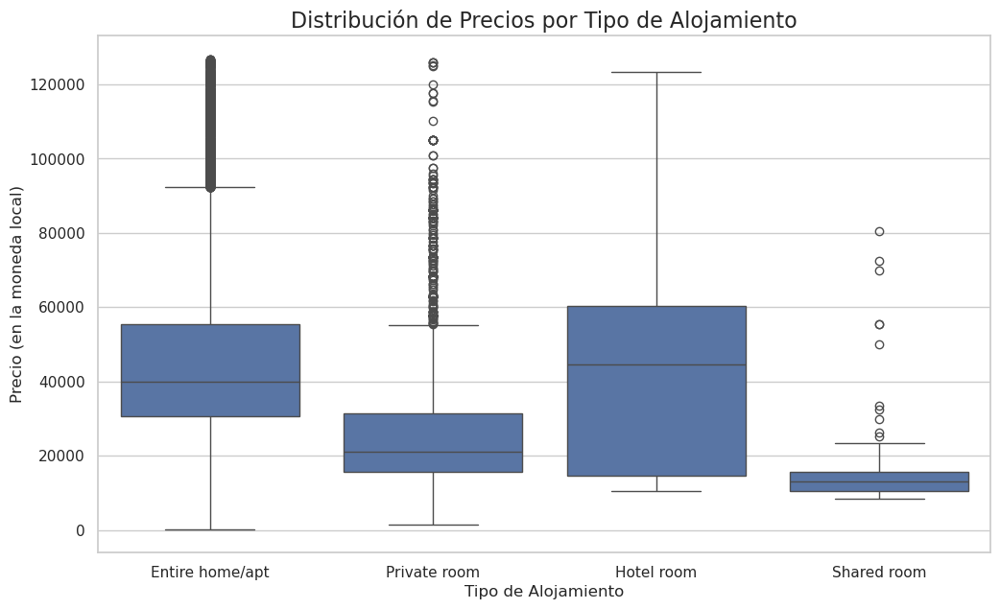

In [67]:
plt.figure(figsize=(12, 7))
# Usamos el dataframe filtrado para una mejor visualización de las cajas
sns.boxplot(x='room_type', y='price', data=df_filtered)

plt.title('Distribución de Precios por Tipo de Alojamiento', fontsize=16)
plt.xlabel('Tipo de Alojamiento', fontsize=12)
plt.ylabel('Precio (en la moneda local)', fontsize=12)
plt.show()

Este conjunto de diagramas de caja (boxplots) permite realizar una comparación directa de las distribuciones de la variable price a través de las cuatro categorías de room_type (Tipo de Alojamiento). Para permitir una comparación visual clara de las medianas y los rangos intercuartílicos, esta gráfica utiliza los datos filtrados por debajo del percentil 95, excluyendo los outliers más extremos.

Observaciones:

Alojamiento entero (Entire home/apt): Esta categoría presenta una mediana de precios elevada y una dispersión considerable. Junto con "Habitación privada", es una de las que más valores atípicos muestra, lo que sugiere una gran heterogeneidad en la calidad y tamaño de las propiedades ofrecidas bajo esta modalidad.

Habitación privada (Private room): Muestra una mediana de precios significativamente más baja. A pesar de su menor costo mediano, exhibe una notable cantidad de valores atípicos, lo que podría indicar la existencia de un sub-mercado de habitaciones privadas "premium" en ubicaciones o con características excepcionales.

Habitación de hotel (Hotel room): Esta categoría presenta la mediana de precios más alta de las cuatro. Su rango intercuartílico (la altura de la caja) es notablemente amplio, lo que indica la mayor variabilidad de precios en el 50% central de su distribución.

Habitación compartida (Shared room): Corresponde, como es de esperar, a la opción más económica. Exhibe tanto la mediana como la dispersión de datos más bajas de todas las categorías, con una cantidad de outliers relativamente menor.

Interpretación y Conclusiones:

El análisis establece una clara y lógica jerarquía de precios que se correlaciona directamente con el nivel de privacidad y el tipo de servicio ofrecido. La mediana de precios sigue, en general, un orden ascendente: Shared room < Private room < Entire home/apt. La categoría Hotel room muestra la mediana más alta.

La variabilidad dentro de cada categoría es también un hallazgo relevante. La alta dispersión en "Hotel room" puede reflejar una amplia gama de calidades (desde hoteles boutique a cadenas de lujo) que utilizan AirBnB como plataforma de venta. Por el contrario, la baja dispersión en "Shared room" sugiere un mercado más homogéneo y con precios estandarizados.

Estos resultados confirman que la variable room_type es un predictor fundamental del precio. Para el futuro modelo de Machine Learning, esta característica categórica será esencial para explicar una porción significativa de la varianza en los precios de los alojamientos.

## 4. ¿Dónde se ubican geográficamente los alojamientos?

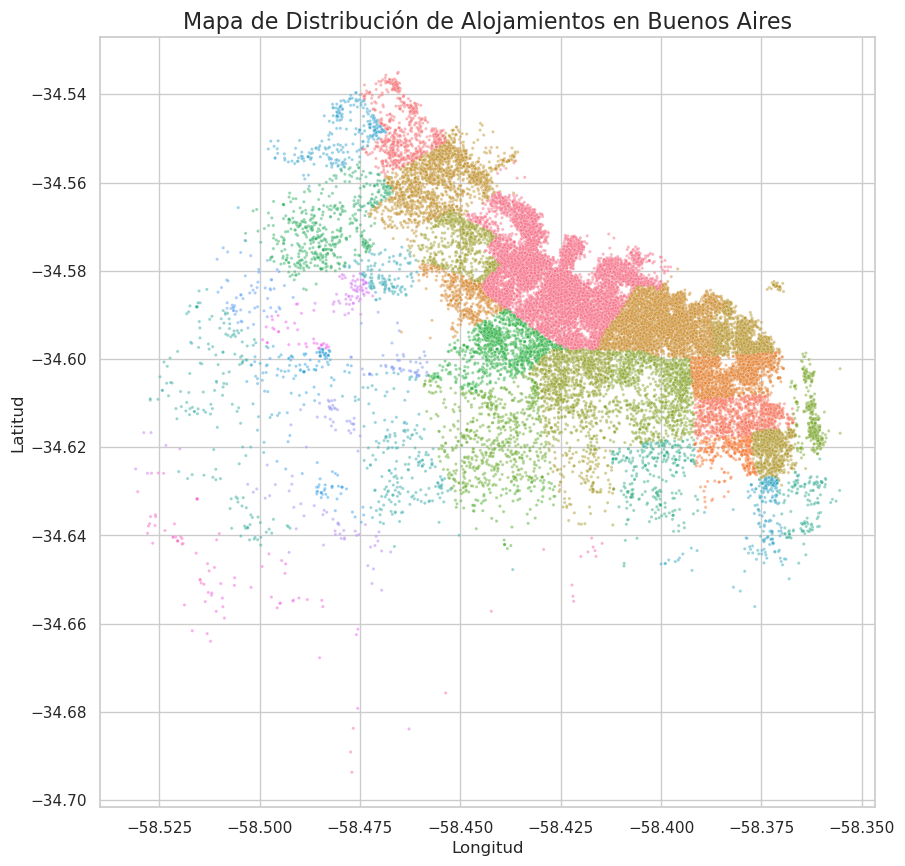

In [68]:
plt.figure(figsize=(10, 10))
sns.scatterplot(
    data=df,
    x='longitude',
    y='latitude',
    hue='neighbourhood',  # Coloreamos por barrio
    s=5,                # Hacemos los puntos más pequeños
    alpha=0.5,            # Añadimos transparencia para ver la densidad
    legend=False        # Ocultamos la leyenda para no saturar el mapa
)

plt.title('Mapa de Distribución de Alojamientos en Buenos Aires', fontsize=16)
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.show()

Este gráfico de dispersión (scatterplot) utiliza las coordenadas geográficas (longitud y latitud) para posicionar cada alojamiento, creando un mapa visual de la oferta de AirBnB en la Ciudad de Buenos Aires. Los puntos están coloreados según el barrio (neighbourhood) al que pertenecen.

Observaciones:

Delineación Geográfica: La distribución de los puntos dibuja de forma bastante precisa la silueta de la Ciudad de Buenos Aires, especialmente el corredor norte y el área central.

Alta Concentración: La densidad de alojamientos no es homogénea. Se observan "clusters" o agrupaciones de alta densidad, particularmente en la zona superior y derecha del gráfico, que se corresponden con los barrios identificados en el análisis anterior (Palermo, Recoleta, etc.).

Segmentación por Barrio: La coloración por barrio permite identificar visualmente los límites y la extensión de cada uno. Por ejemplo, se puede distinguir la gran mancha de color correspondiente a Palermo.

Zonas de Baja Densidad: Existen áreas con una densidad de puntos notablemente menor o nula. Estas zonas probablemente corresponden a grandes parques, áreas industriales, o barrios residenciales con una oferta turística muy limitada.

Interpretación y Conclusiones:

Esta visualización geoespacial confirma de manera contundente las conclusiones del gráfico de barras: la oferta de AirBnB está fuertemente concentrada en el corredor norte de la ciudad. La densidad de los alojamientos sirve como un proxy visual de la actividad turística y comercial. La capacidad de delinear los barrios a partir de la ubicación de los listados demuestra la fuerte segmentación del mercado a nivel geográfico.

In [69]:
import folium
from folium.plugins import MarkerCluster

# 1. Crear un mapa base centrado en Buenos Aires
mapa_cluster = folium.Map(location=[-34.6037, -58.3816], zoom_start=12)

# 2. Crear un objeto de MarkerCluster
#    Esto se encargará de agrupar los puntos automáticamente.
marker_cluster = MarkerCluster().add_to(mapa_cluster)

# 3. Iterar sobre TODO el DataFrame y añadir cada punto al CLUSTER, no al mapa directamente
for index, row in df.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"<b>Nombre:</b> {row['name']}<br>"
              f"<b>Precio:</b> ${row['price']}"
    ).add_to(marker_cluster) # ¡Se añade al objeto cluster!

# 4. Mostrar el mapa
mapa_cluster

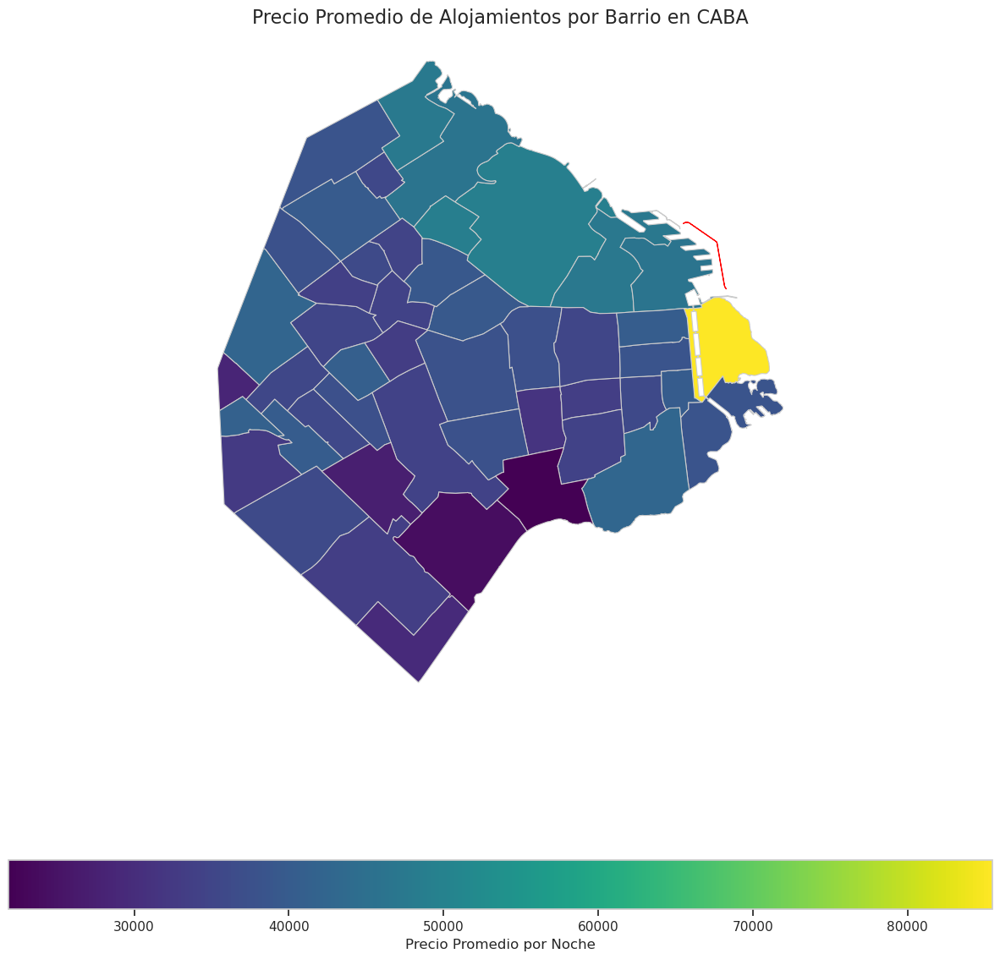

In [70]:
# Calcular el precio promedio por barrio desde tu DataFrame principal 'df'
# Usamos el df filtrado de outliers para que el promedio no se dispare
price_limit = df['price'].quantile(0.95)
df_filtered = df[df['price'] < price_limit]
precio_promedio_barrio = df_filtered.groupby('neighbourhood')['price'].mean().reset_index()

# Unir los datos de precios promedio con el GeoDataFrame de barrios
mapa_data = gdf_barrios.merge(precio_promedio_barrio, on='neighbourhood', how='left')

# Crear el mapa de coropletas
fig, ax = plt.subplots(1, 1, figsize=(15, 15))

mapa_data.plot(column='price', # Columna que define el color
               cmap='viridis',    # Paleta de colores (puedes probar 'plasma', 'inferno', 'magma')
               linewidth=0.8,
               ax=ax,
               edgecolor='0.8',
               legend=True,
               legend_kwds={'label': "Precio Promedio por Noche",
                            'orientation': "horizontal"},
               missing_kwds={"color": "lightgrey",
                             "edgecolor": "red",
                             "hatch": "///",
                             "label": "Sin datos"}
              )

# Ocultar los ejes de latitud/longitud para una mejor apariencia
ax.axis('off')

# Añadir el título
ax.set_title('Precio Promedio de Alojamientos por Barrio en CABA', fontdict={'fontsize': '16', 'fontweight': '3'})

plt.show()

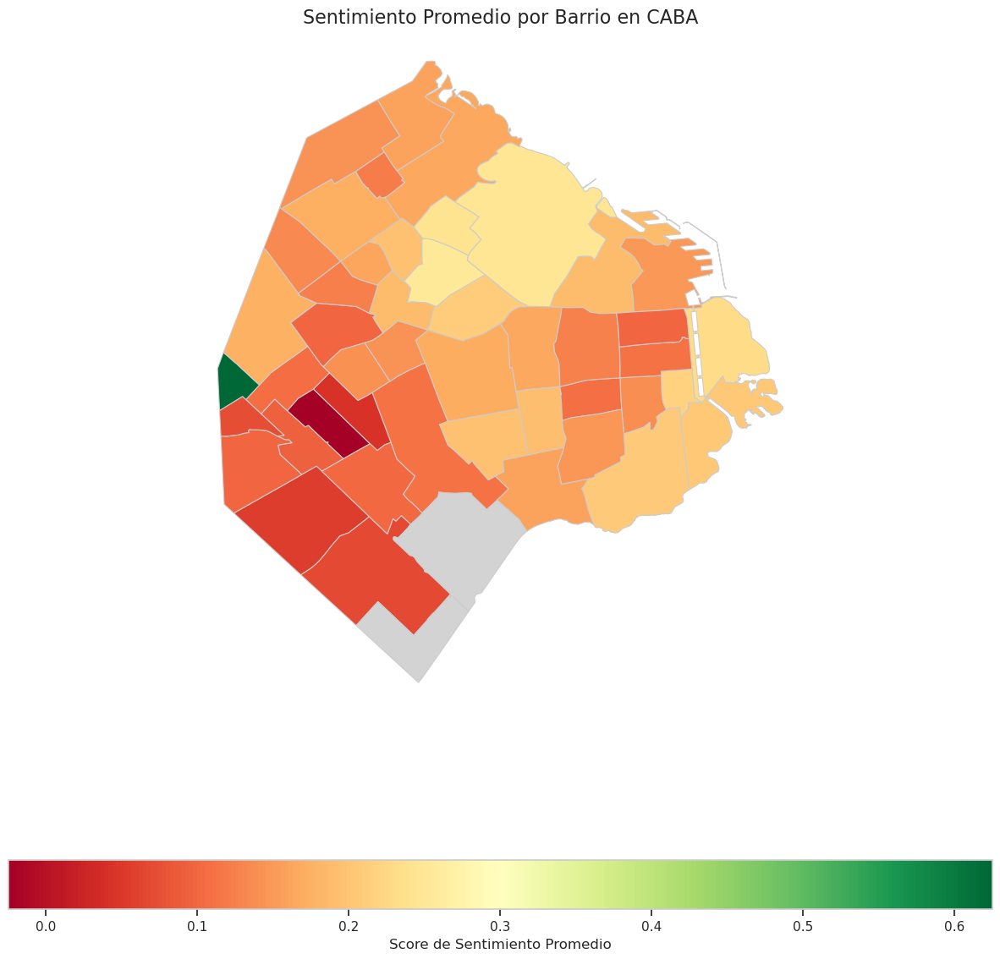

In [71]:
# Este código asume que 'df' ya tiene la columna 'sentiment_score'
# y que 'gdf_barrios' está cargado.

# Paso 1: Calcular el sentimiento promedio por barrio
sentiment_barrio = df.groupby('neighbourhood')['sentiment_score'].mean().reset_index()

# Paso 2: Unir los datos de sentimiento con el GeoDataFrame
mapa_data_sentimiento = gdf_barrios.merge(sentiment_barrio, on='neighbourhood', how='left')

# Paso 3: Crear el mapa de coropletas
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
mapa_data_sentimiento.plot(
    column='sentiment_score', # Columna que define el color
    cmap='RdYlGn',           # Paleta de colores: Rojo (malo) - Amarillo (neutro) - Verde (bueno)
    linewidth=0.8,
    ax=ax,
    edgecolor='0.8',
    legend=True,
    legend_kwds={'label': "Score de Sentimiento Promedio",
                 'orientation': "horizontal"},
    missing_kwds={"color": "lightgrey", "label": "Sin datos"}
)

# Configuración del gráfico
ax.axis('off')
ax.set_title('Sentimiento Promedio por Barrio en CABA', fontdict={'fontsize': '16', 'fontweight': '3'})
plt.show()

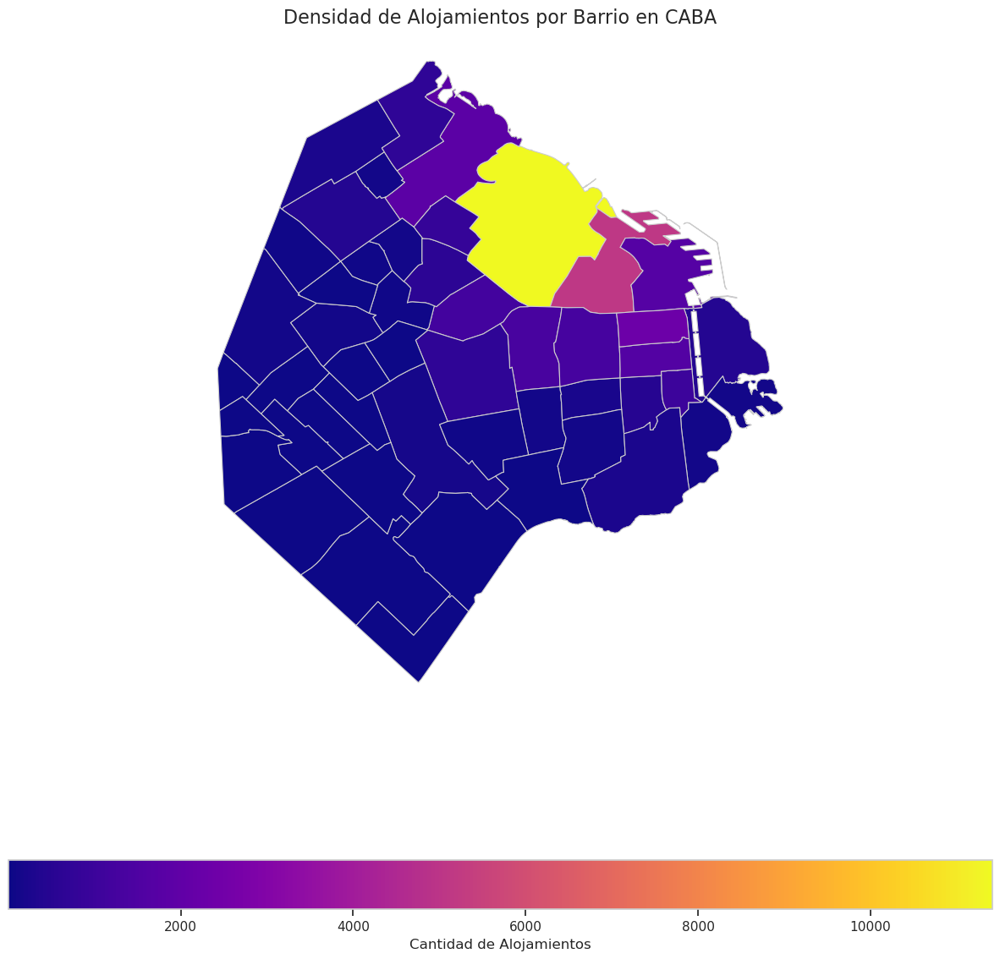

In [72]:
# Este código asume que 'df' y 'gdf_barrios' están cargados.

# Paso 1: Contar la cantidad de alojamientos por barrio
densidad_alojamientos = df['neighbourhood'].value_counts().reset_index()
densidad_alojamientos.columns = ['neighbourhood', 'cantidad_alojamientos']

# Paso 2: Unir los datos de densidad con el GeoDataFrame
mapa_data_densidad = gdf_barrios.merge(densidad_alojamientos, on='neighbourhood', how='left')

# Paso 3: Crear el mapa de coropletas
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
mapa_data_densidad.plot(
    column='cantidad_alojamientos', # Columna que define el color
    cmap='plasma',                 # Paleta de colores para datos secuenciales (de menos a más)
    linewidth=0.8,
    ax=ax,
    edgecolor='0.8',
    legend=True,
    legend_kwds={'label': "Cantidad de Alojamientos",
                 'orientation': "horizontal"},
    missing_kwds={"color": "lightgrey", "label": "Sin datos"}
)

# Configuración del gráfico
ax.axis('off')
ax.set_title('Densidad de Alojamientos por Barrio en CABA', fontdict={'fontsize': '16', 'fontweight': '3'})
plt.show()

##  Análisis de Estacionalidad de Precios

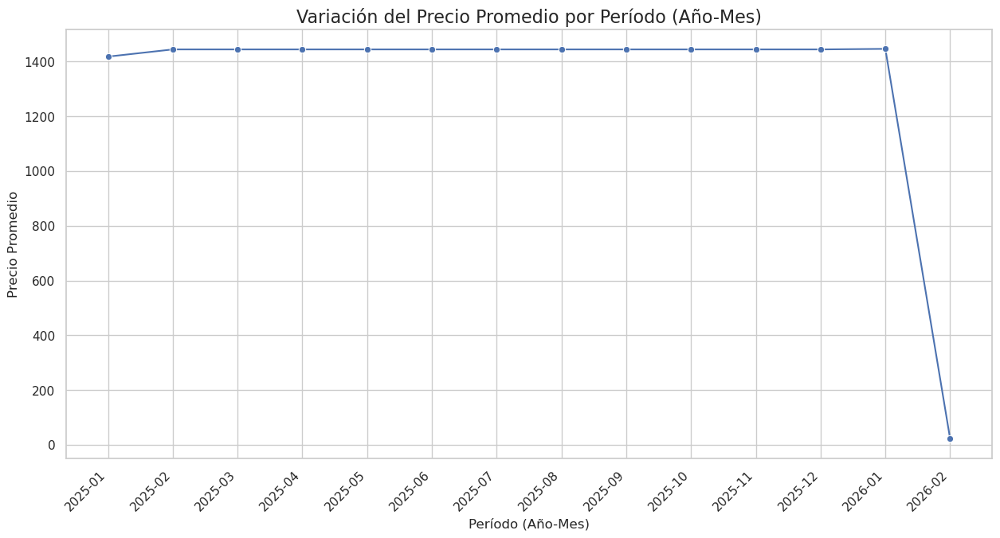

In [73]:
# Crear una columna con el período 'Año-Mes'
df_calendar['periodo'] = df_calendar['date'].dt.to_period('M')

# Agrupar por el nuevo período y calcular el precio promedio
precio_periodo = df_calendar.groupby('periodo')['price'].mean().reset_index()

# Convertir el período a string para graficarlo correctamente
precio_periodo['periodo'] = precio_periodo['periodo'].astype(str)

# Graficar los resultados
plt.figure(figsize=(15, 7))
sns.lineplot(x='periodo', y='price', data=precio_periodo, marker='o', sort=False)

plt.title('Variación del Precio Promedio por Período (Año-Mes)', fontsize=16)
plt.xlabel('Período (Año-Mes)', fontsize=12)
plt.ylabel('Precio Promedio', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.show()

El prolongado período de precios promedio estáticos, que abarca desde febrero de 2025 hasta enero de 2026, demuestra que los datos no reflejan una dinámica de mercado real, sino un conjunto de precios base predeterminados por los anfitriones para fechas lejanas. La drástica caída en el último período (febrero de 2026) se interpreta como un artefacto del fin del conjunto de datos, resultando en un cálculo sobre un período incompleto y no representativo.

Por lo tanto, se concluye que la utilidad de este archivo se limita a la ingeniería de características a corto plazo y no a la identificación de tendencias temporales extendidas.

## Análisis de Distribución de Sentimiento

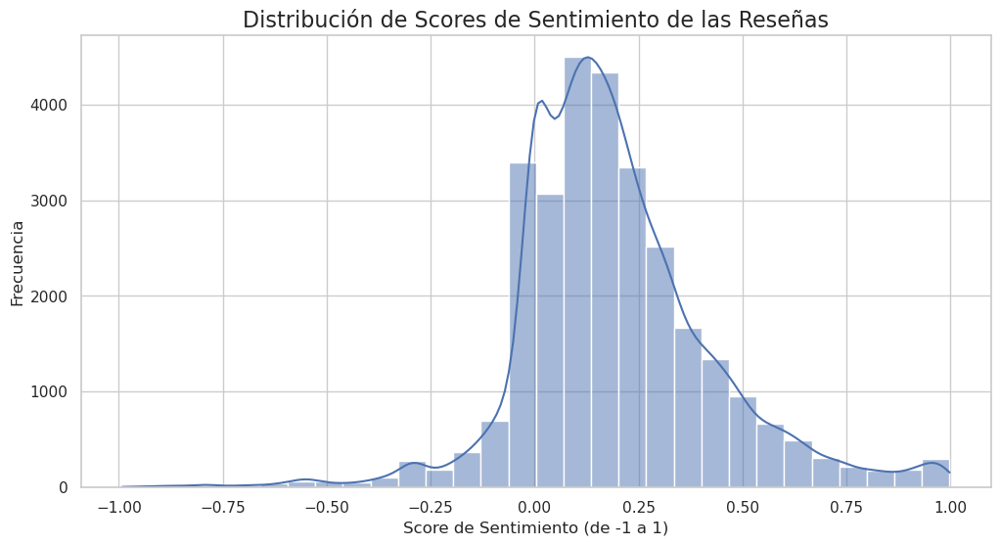

In [74]:
# Este código asume que ya has añadido la columna 'sentiment_score' a tu DataFrame 'df'
plt.figure(figsize=(12, 6))
sns.histplot(df['sentiment_score'].dropna(), bins=30, kde=True)

plt.title('Distribución de Scores de Sentimiento de las Reseñas', fontsize=16)
plt.xlabel('Score de Sentimiento (de -1 a 1)', fontsize=12)
plt.ylabel('Frecuencia', fontsize=12)
plt.show()

# Hallazgos sobre la Distribución del Sentimiento en las Reseñas

El análisis de la distribución de los scores de sentimiento revela un panorama general marcadamente favorable. El hallazgo principal es que la opinión más frecuente no es la neutralidad, sino un sentimiento ligeramente positivo, con la mayor concentración de reseñas situándose en un score de entre 0.15 y 0.25. Esta tendencia se ve reforzada por la forma asimétrica de la distribución, que muestra un volumen de opiniones positivas considerablemente mayor que el de las negativas. De hecho, las críticas fuertemente desfavorables son notablemente escasas en el conjunto de datos, lo que constituye una señal muy positiva.

A pesar de este claro sesgo positivo, es importante matizar que el sentimiento favorable es predominantemente moderado. La mayoría de las opiniones se agrupan en la parte baja de la escala positiva (entre 0.0 y 0.5), sugiriendo una satisfacción general pero no un entusiasmo desbordante. Esto podría indicar que, si bien los usuarios están contentos, existen aspectos recurrentes que impiden que la experiencia sea calificada como "perfecta". Finalmente, el gráfico también deja entrever la existencia de pequeños pero significativos grupos en los extremos: un núcleo de "fans" con opiniones extremadamente positivas y, en menor medida, uno de "detractores" con scores muy bajos, cuyas voces, aunque minoritarias, suelen aportar un feedback muy valioso y directo.

## Análisis de la Relación entre Sentimiento y Precio

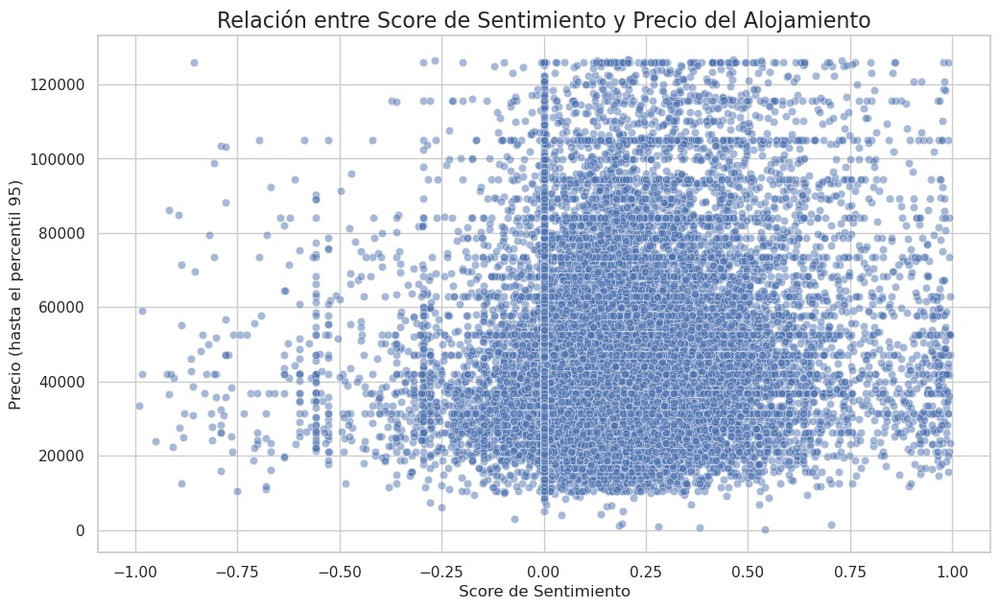

In [75]:
# Para una mejor visualización, es recomendable filtrar los precios extremos
price_limit = df['price'].quantile(0.95)
df_filtered_viz = df[df['price'] < price_limit]

plt.figure(figsize=(12, 7))
sns.scatterplot(data=df_filtered_viz, x='sentiment_score', y='price', alpha=0.5)

plt.title('Relación entre Score de Sentimiento y Precio del Alojamiento', fontsize=16)
plt.xlabel('Score de Sentimiento', fontsize=12)
plt.ylabel('Precio (hasta el percentil 95)', fontsize=12)
plt.show()

# Hallazgos sobre la Relación entre Sentimiento y Precio

Al examinar la relación entre el score de sentimiento y el precio del alojamiento, el hallazgo más contundente es la notable ausencia de una correlación directa. El gráfico de dispersión presenta una nube de puntos densa y sin una tendencia definida, demostrando de manera concluyente que el precio no es un predictor fiable de la calidad de la experiencia percibida por los usuarios. Un alojamiento de alto costo no garantiza una reseña positiva, así como un precio bajo no implica necesariamente una opinión desfavorable.

La mayor densidad de puntos se concentra, de forma coherente con el análisis de distribución previo, en la franja de sentimiento positivo-moderado y en un rango de precios de bajo a medio. Esto dibuja el perfil del alojamiento más común dentro del conjunto de datos: una opción asequible que genera, en general, una satisfacción favorable. Quizás el descubrimiento más revelador se encuentra en los extremos de la distribución: es posible encontrar alojamientos con calificaciones excelentes en todos los niveles de precio, desde los más económicos hasta los más elevados. De la misma forma, las experiencias negativas también aparecen distribuidas a lo largo de todo el espectro de costos. Este hallazgo subraya de forma definitiva que la calidad, desde la perspectiva del usuario, es un atributo que se demuestra independiente del precio.

[nltk_data] Downloading package punkt to /home/seba/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /home/seba/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
/tmp/ipykernel_7458/1930211907.py:59: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='frecuencia', y='bigrama', data=df_plot_pos, ax=axes[0], palette='Greens_r')
/tmp/ipykernel_7458/1930211907.py:61: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='frecuencia', y='bigrama', data=df_plot_neg, ax=axes[1], palette='Reds_r')


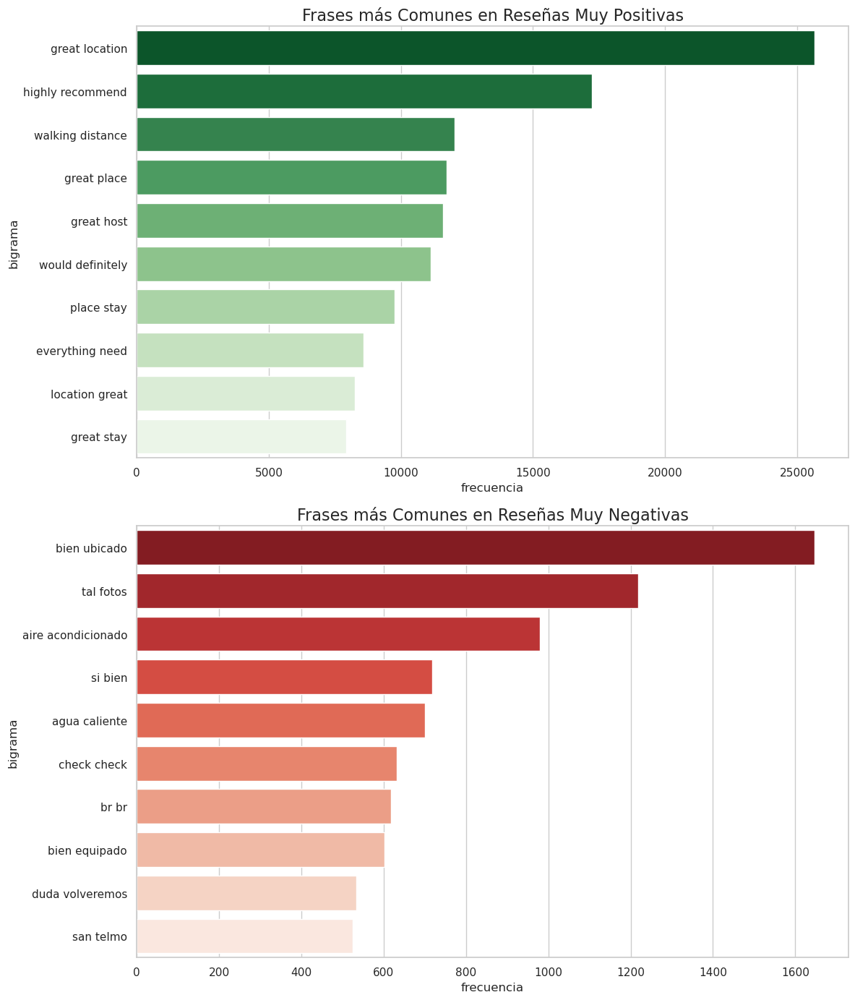

In [76]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
from collections import Counter
import re
import matplotlib.pyplot as plt
import seaborn as sns

# --- Preparación de NLTK (solo se necesita la primera vez) ---
# Descargamos las listas de stopwords para los idiomzzas más comunes
nltk.download('punkt')
nltk.download('stopwords')
# -----------------------------------------------------------

# Este código asume que 'df_reviews_cleaned' existe y tiene las columnas 'comments' y 'sentiment_score'
# 1. Usar umbrales más estrictos para una mejor separación
df_positivas = df_reviews_cleaned[df_reviews_cleaned['sentiment_score'] >= 0.7]
df_negativas = df_reviews_cleaned[df_reviews_cleaned['sentiment_score'] <= -0.6]

# 2. Función mejorada para procesar texto y extraer bigramas
def obtener_top_bigramas_definitivo(corpus, n=10):
    texto_completo = ' '.join(corpus.astype(str)).lower()
    palabras = re.findall(r'\b[a-z]{2,}\b', texto_completo)

    # --- LISTA DE STOPWORDS DEFINITIVA ---
    stop_words = set(stopwords.words('spanish'))
    stop_words.update(stopwords.words('english'))
    stop_words.update(stopwords.words('portuguese'))
    stop_words.update(stopwords.words('french'))
    stop_words.update(stopwords.words('german'))

    # Palabras personalizadas
    stop_words.update(['muy', 'todo', 'gracias', 'mas', 'airbnb', 'buenos', 'aires',
                       'departamento', 'apartamento', 'apartment', 'estadia', 'excelente',
                       'super', 'recomiendo', 'lugar', 'zona', 'ubicacion'])

    palabras_filtradas = [palabra for palabra in palabras if palabra not in stop_words]

    bigramas = nltk.bigrams(palabras_filtradas)
    frecuencia_bigramas = Counter(bigramas)

    return frecuencia_bigramas.most_common(n)

# --- Volver a ejecutar el proceso con la función definitiva ---
top_bigramas_positivos = obtener_top_bigramas_definitivo(df_positivas['comments'])
top_bigramas_negativos = obtener_top_bigramas_definitivo(df_negativas['comments'])

# (El resto del código para preparar y mostrar los gráficos no necesita cambios)

# Preparar datos para graficar
df_plot_pos = pd.DataFrame(top_bigramas_positivos, columns=['bigrama', 'frecuencia'])
df_plot_pos['bigrama'] = df_plot_pos['bigrama'].apply(lambda x: ' '.join(x))

df_plot_neg = pd.DataFrame(top_bigramas_negativos, columns=['bigrama', 'frecuencia'])
df_plot_neg['bigrama'] = df_plot_neg['bigrama'].apply(lambda x: ' '.join(x))

# Crear los gráficos
fig, axes = plt.subplots(2, 1, figsize=(12, 14))
sns.barplot(x='frecuencia', y='bigrama', data=df_plot_pos, ax=axes[0], palette='Greens_r')
axes[0].set_title('Frases más Comunes en Reseñas Muy Positivas', fontsize=16)
sns.barplot(x='frecuencia', y='bigrama', data=df_plot_neg, ax=axes[1], palette='Reds_r')
axes[1].set_title('Frases más Comunes en Reseñas Muy Negativas', fontsize=16)
plt.tight_layout()
plt.show()

Conclusiones del Análisis de N-gramas

El análisis de N-gramas, tras la aplicación de un robusto filtro de stopwords multilingüe y personalizado, ha permitido extraer las frases de dos palabras (bigramas) más frecuentes en las reseñas, revelando los factores específicos que impulsan la satisfacción e insatisfacción de los huéspedes.

 Análisis de Reseñas Positivas

La gráfica superior muestra los bigramas dominantes en las reseñas con un sentimiento marcadamente positivo.

* **Observaciones:** Las frases más frecuentes son `great location`, `highly recommend`, `walking distance`, `great place` y `great host`.
* **Conclusión:** Se concluye que los factores clave para una alta satisfacción del huésped están fuertemente ligados a la **ubicación** (`great location`, `walking distance`) y a la **calidad intrínseca del servicio y la hospitalidad** (`great host`, `highly recommend`). Esto sugiere que la conveniencia geográfica y la hospitalidad del anfitrión son los principales impulsores de las experiencias positivas.

Análisis de Reseñas Negativas

La gráfica inferior presenta los bigramas más comunes en reseñas con sentimiento negativo, cuyo análisis es más matizado.

* **Observaciones:** Emergen frases que apuntan a problemas concretos como `aire acondicionado` y `agua caliente`, así como la frase `tal fotos`. Sin embargo, también aparecen frases de connotación positiva como `bien ubicado`.
* **Conclusión:** Este análisis revela dos puntos importantes:
    1.  **Problemas Específicos:** Las quejas más recurrentes se centran en el **funcionamiento de los servicios y equipamiento** (`aire acondicionado`, `agua caliente`). La frase `tal fotos` sugiere una **discrepancia entre las expectativas** generadas por el anuncio y la realidad encontrada por el huésped.
    2.  **Complejidad de las Opiniones:** La presencia de `bien ubicado` en reseñas negativas es un hallazgo crítico. Indica que las opiniones de los huéspedes son complejas; una reseña puede ser clasificada como negativa en general, pero aun así contener elementos positivos. Un huésped puede valorar la ubicación pero calificar negativamente la estancia debido a otros fallos.

En resumen, el análisis de N-gramas ha demostrado ser una técnica efectiva para ir más allá de un simple score de sentimiento, identificando los atributos específicos que generan satisfacción (ubicación, anfitrión) e insatisfacción (servicios, veracidad de las fotos).

/tmp/ipykernel_7458/1812949606.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=conteo_categorias.index, y=conteo_categorias.values, palette='mako')


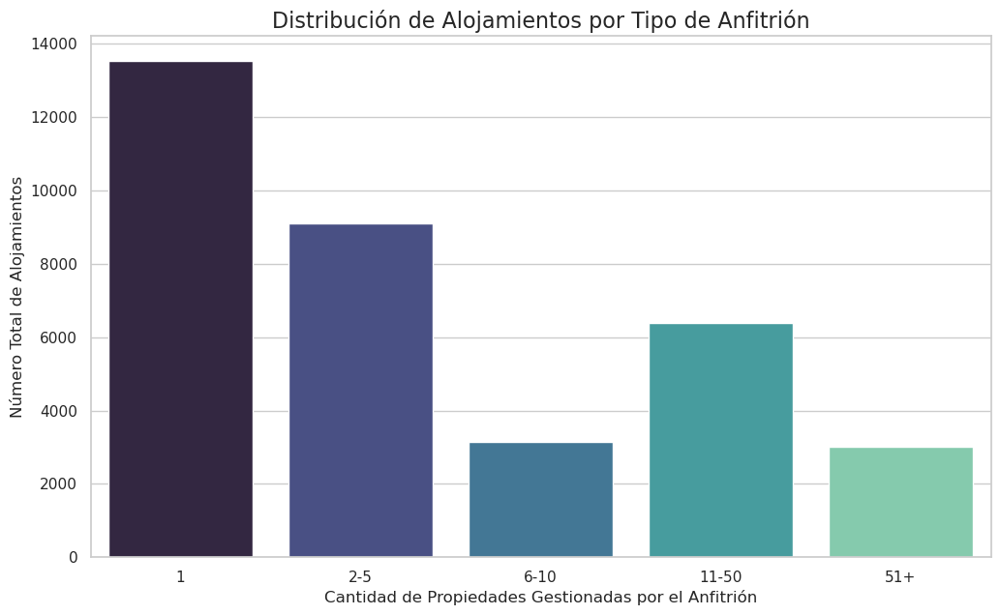

In [77]:
# 1. Crear categorías (bins) para la cantidad de propiedades por anfitrión
bins = [0, 1, 5, 10, 50, float('inf')]
labels = ['1', '2-5', '6-10', '11-50', '51+']
df['categoria_anfitrion'] = pd.cut(df['calculated_host_listings_count'], bins=bins, labels=labels, right=True)

# 2. Contar la cantidad de alojamientos en cada categoría
conteo_categorias = df['categoria_anfitrion'].value_counts().sort_index()

# 3. Crear el gráfico de barras
plt.figure(figsize=(12, 7))
sns.barplot(x=conteo_categorias.index, y=conteo_categorias.values, palette='mako')

plt.title('Distribución de Alojamientos por Tipo de Anfitrión', fontsize=16)
plt.xlabel('Cantidad de Propiedades Gestionadas por el Anfitrión', fontsize=12)
plt.ylabel('Número Total de Alojamientos', fontsize=12)
plt.show()

Conclusiones del Análisis de Distribución por Anfitrión

Este gráfico de barras clasifica el total de alojamientos según la cantidad de propiedades que gestiona cada anfitrión. El objetivo es analizar la estructura de la oferta del mercado en la Ciudad de Buenos Aires.

**Observaciones:**

* **Dominancia de Anfitriones Individuales:** La categoría más numerosa, con más de 13,000 alojamientos, corresponde a anfitriones que gestionan **una única propiedad**. Esto sugiere que una parte muy sustancial del mercado está compuesta por particulares que alquilan su propia vivienda o una segunda propiedad.

* **Peso de los Anfitriones con Múltiples Propiedades:** A pesar de la dominancia de la primera categoría, la suma de los alojamientos gestionados por anfitriones con dos o más propiedades es mayoritaria. Las categorías "2-5" y "11-50" son particularmente significativas, representando en conjunto a más de 15,000 alojamientos.

* **Presencia de Empresas Profesionales:** La existencia de categorías como "11-50" (más de 6,000 alojamientos) y "51+" (alrededor de 3,000 alojamientos) indica una notable presencia de **empresas o anfitriones profesionales** que operan a gran escala en la plataforma, lo que señala una profesionalización del sector.

**Interpretación y Conclusiones:**

El mercado de la oferta de AirBnB en Buenos Aires es **híbrido y diversificado**. No está monopolizado ni por particulares ni por grandes empresas, sino que presenta una coexistencia saludable de ambos modelos de negocio.

Por un lado, la fuerte base de anfitriones con una sola propiedad mantiene el espíritu original de la plataforma de "economía compartida". Por otro lado, la considerable cantidad de propiedades en manos de gestores con múltiples anuncios demuestra que se ha convertido en un mercado inmobiliario profesionalizado.

Para un análisis futuro, sería de gran interés investigar si existen diferencias sistemáticas en el precio, la calidad (reflejada en el `sentiment_score`) o la tasa de ocupación entre los alojamientos gestionados por anfitriones individuales y aquellos gestionados por profesionales.

--- Top 10 de Anfitriones por Cantidad de Propiedades ---


,host_id,host_name,calculated_host_listings_count
791,11256892,HomelyJoy,222
4633,1021694,Fliphaus,188
281,3469227,Federico,182
1879,55553719,For Rent Argentina,174
4431,132838002,Pablo,133
12443,469282547,Fernando,116
2923,210147055,Ángel,110
6857,278440549,Boutique Apartments,98
1374,10966956,Vero Y Clara,97
2522,51699880,Lorena,96


/tmp/ipykernel_7458/2147034932.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='calculated_host_listings_count', y='host_name', data=top_15_hosts, palette='viridis')


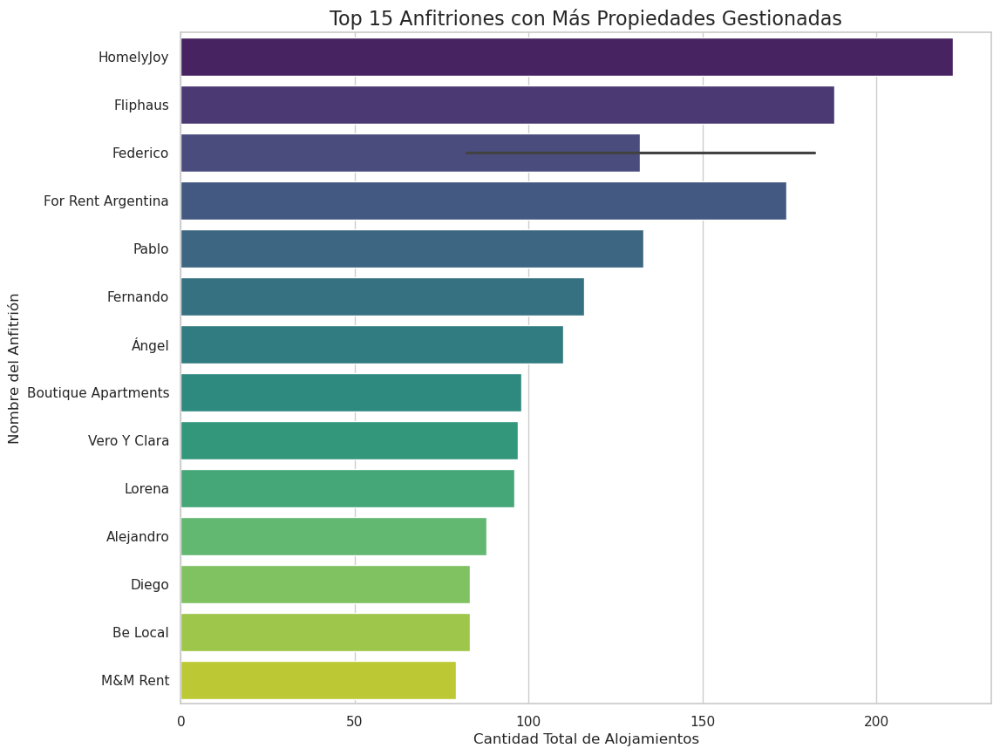

In [78]:

# 1. Crear un DataFrame con información única por anfitrión
#    Seleccionamos las columnas relevantes y eliminamos duplicados por 'host_id'
df_hosts = df[['host_id', 'host_name', 'calculated_host_listings_count']].drop_duplicates(subset=['host_id'])

# 2. Ordenar el DataFrame para crear el ranking
df_ranking_hosts = df_hosts.sort_values(by='calculated_host_listings_count', ascending=False)

# 3. Mostrar el top 10 en formato de tabla
print("--- Top 10 de Anfitriones por Cantidad de Propiedades ---")
display(df_ranking_hosts.head(10))

# 4. Visualizar el top 15 en un gráfico de barras horizontales
#    (Usamos 15 para más contexto y barras horizontales para que los nombres se lean mejor)
top_15_hosts = df_ranking_hosts.head(15)

plt.figure(figsize=(12, 10))
sns.barplot(x='calculated_host_listings_count', y='host_name', data=top_15_hosts, palette='viridis')

plt.title('Top 15 Anfitriones con Más Propiedades Gestionadas', fontsize=16)
plt.xlabel('Cantidad Total de Alojamientos', fontsize=12)
plt.ylabel('Nombre del Anfitrión', fontsize=12)
plt.show()

Conclusiones del Ranking de Anfitriones

Este gráfico de barras horizontales presenta un ranking de los 15 principales anfitriones según la cantidad total de propiedades que gestionan. Este análisis permite identificar a los actores clave en la oferta del mercado.

* **Identificación de Actores Dominantes:** El gráfico identifica claramente a los principales operadores del mercado en Buenos Aires. Los anfitriones **"Homelyjoy" y "Fliphaus"** se destacan significativamente, gestionando más de 190 propiedades cada uno, lo que los posiciona como los actores dominantes en la plataforma.

* **Coexistencia de Empresas y Particulares a Gran Escala:** La lista del top 15 revela una mezcla de nombres que sugieren ser corporativos (ej. `Homelyjoy`, `For Rent Argentina`, `Boutique Apartments`) y nombres de pila (ej. `Federico`, `Pablo`, `Fernando`). Esto refuerza la conclusión del análisis anterior sobre la **naturaleza híbrida del mercado**, donde coexisten empresas de gestión profesional con individuos que, aunque posiblemente operen como empresas, lo hacen bajo un nombre personal a gran escala.

* **Detección de una Anomalía en los Datos:** Se detecta una anomalía visual en el anfitrión "Federico", representado con una barra de error. Esto indica que existen múltiples entidades de anfitriones operando bajo el mismo nombre pero con un número de propiedades diferente, lo que provoca que la librería de visualización calcule una media y su intervalo de confianza. Este hallazgo subraya la **ambigüedad de utilizar `host_name` como identificador único** y la importancia de basar los análisis en la variable `host_id` para garantizar la precisión.

En conclusión, el ranking no solo cuantifica la escala de los mayores operadores, sino que también expone potenciales problemas de calidad y ambigüedad en los datos. Confirma la existencia de un mercado profesionalizado donde un número reducido de actores controla una porción considerable del inventario total de alojamientos.

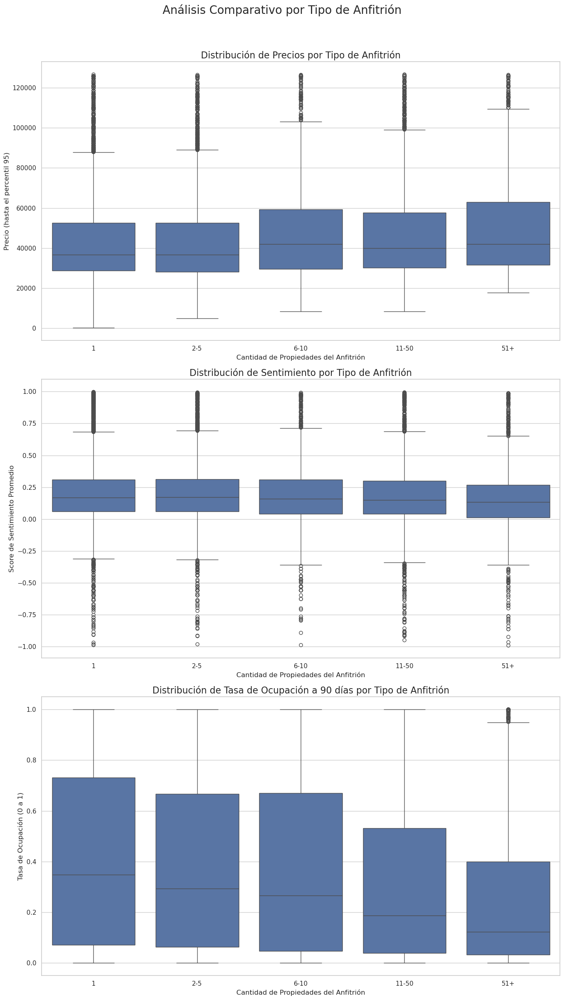

In [79]:
# 1. Crear una figura con 3 subplots verticales
fig, axes = plt.subplots(3, 1, figsize=(14, 24))
fig.suptitle('Análisis Comparativo por Tipo de Anfitrión', fontsize=20, y=1.02)

# Orden de las categorías para los gráficos
order = ['1', '2-5', '6-10', '11-50', '51+']

# --- Gráfico 1: Comparación de Precios ---
# Filtramos outliers de precio para una mejor visualización
price_limit = df['price'].quantile(0.95)
df_filtered_price = df[df['price'] < price_limit]

sns.boxplot(ax=axes[0], x='categoria_anfitrion', y='price', data=df_filtered_price, order=order)
axes[0].set_title('Distribución de Precios por Tipo de Anfitrión', fontsize=16)
axes[0].set_xlabel('Cantidad de Propiedades del Anfitrión', fontsize=12)
axes[0].set_ylabel('Precio (hasta el percentil 95)', fontsize=12)


# --- Gráfico 2: Comparación de Sentimiento de Reseñas ---
sns.boxplot(ax=axes[1], x='categoria_anfitrion', y='sentiment_score', data=df, order=order)
axes[1].set_title('Distribución de Sentimiento por Tipo de Anfitrión', fontsize=16)
axes[1].set_xlabel('Cantidad de Propiedades del Anfitrión', fontsize=12)
axes[1].set_ylabel('Score de Sentimiento Promedio', fontsize=12)


# --- Gráfico 3: Comparación de Tasa de Ocupación ---
sns.boxplot(ax=axes[2], x='categoria_anfitrion', y='tasa_ocupacion_90d', data=df, order=order)
axes[2].set_title('Distribución de Tasa de Ocupación a 90 días por Tipo de Anfitrión', fontsize=16)
axes[2].set_xlabel('Cantidad de Propiedades del Anfitrión', fontsize=12)
axes[2].set_ylabel('Tasa de Ocupación (0 a 1)', fontsize=12)


# Ajustar el layout y mostrar los gráficos
plt.tight_layout()
plt.show()

### Conclusiones del Análisis Comparativo por Tipo de Anfitrión

Este análisis compara tres métricas de rendimiento clave (`precio`, `sentiment_score` y `tasa_ocupacion_90d`) a través de los distintos segmentos de anfitriones, con el fin de identificar diferencias sistemáticas en su gestión y resultados.

1.  **En Relación al Precio:**
    Se observa una **tendencia ligeramente positiva** en el precio mediano a medida que aumenta el número de propiedades gestionadas. Los anfitriones de mayor escala ("51+") tienden a fijar precios medianos marginalmente superiores a los de los anfitriones individuales ("1"). Esto podría sugerir que los gestores profesionales aplican estrategias de precios más optimizadas o que su portafolio se concentra en propiedades de mayor valor.

2.  **En Relación a la Calidad (Sentimiento de Reseñas):**
    Contrariamente a lo que se podría esperar, **no se encontraron diferencias sistemáticas significativas en el `sentiment_score`** entre las distintas categorías de anfitriones. La distribución de la satisfacción del huésped es notablemente similar en todos los segmentos, con medianas casi idénticas. Esto sugiere que tanto el "toque personal" de los anfitriones individuales como los estándares de los gestores profesionales son capaces de generar, en promedio, niveles de calidad percibida equivalentes.

3.  **En Relación a la Tasa de Ocupación:**
    El hallazgo más contraintuitivo es la **clara tendencia negativa en la tasa de ocupación a 90 días** a medida que aumenta la escala del anfitrión. Los anfitriones con una sola propiedad exhiben la mediana de ocupación más alta, mientras que esta disminuye progresivamente para los anfitriones con portafolios más grandes. Una posible hipótesis para este fenómeno es que los gestores profesionales mantienen una mayor parte de su inventario disponible para capturar reservas flexibles, mientras que los anfitriones individuales podrían tener propiedades de muy alta demanda constante o una estrategia de disponibilidad más restringida y planificada.

En resumen, el tipo de anfitrión parece tener una influencia moderada y positiva en el precio, una influencia notablemente inversa en la tasa de ocupación, y sorprendentemente, no parece ser un factor determinante en la calidad percibida por los huéspedes.

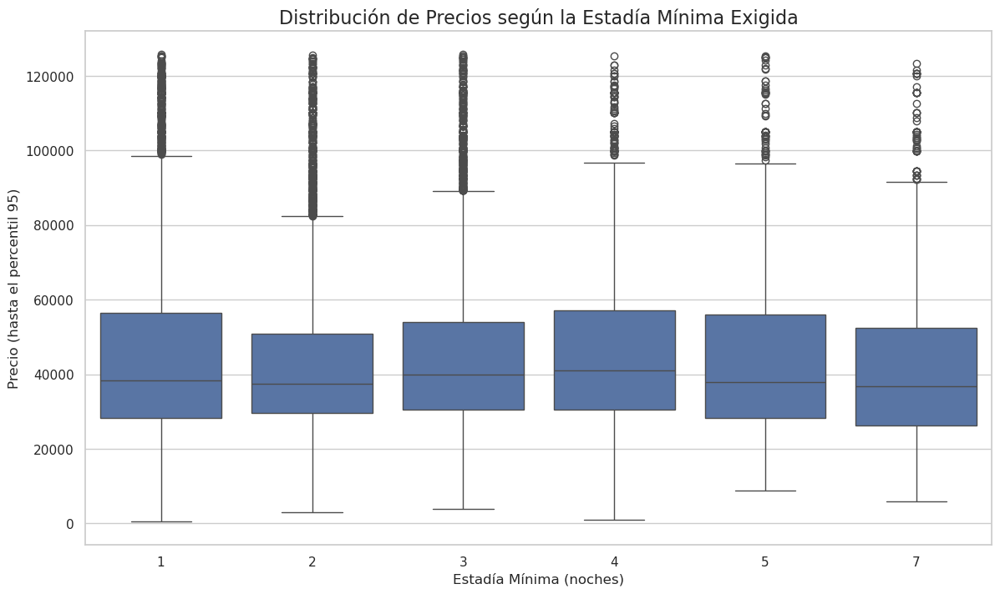

In [80]:

# 1. Identificar los valores más comunes de estadía mínima para analizar
#    (ej. los 6 más frecuentes)
top_min_nights = df['minimum_nights'].value_counts().nlargest(6).index

# 2. Filtrar el DataFrame para incluir solo esos valores
df_min_nights = df[df['minimum_nights'].isin(top_min_nights)]

# 3. Filtrar outliers de precio para una mejor visualización de las cajas
price_limit = df_min_nights['price'].quantile(0.95)
df_filtered_final = df_min_nights[df_min_nights['price'] < price_limit]

# 4. Crear el gráfico de cajas
plt.figure(figsize=(14, 8))
sns.boxplot(x='minimum_nights', y='price', data=df_filtered_final,
            order=sorted(top_min_nights)) # Ordenamos el eje x

plt.title('Distribución de Precios según la Estadía Mínima Exigida', fontsize=16)
plt.xlabel('Estadía Mínima (noches)', fontsize=12)
plt.ylabel('Precio (hasta el percentil 95)', fontsize=12)
plt.show()

### Conclusiones del Análisis de Precios por Estadía Mínima

Este conjunto de diagramas de caja fue generado para investigar si existe una relación sistemática entre la política de estadía mínima (`minimum_nights`) y la distribución de precios de los alojamientos.

* **Ausencia de una Relación Clara:** El hallazgo principal de esta visualización es la **ausencia de una tendencia o correlación evidente** entre la cantidad de noches mínimas exigidas y el nivel de precios, al menos para los valores más frecuentes (1 a 7 noches).

* **Similitud en las Distribuciones de Precios:** Se observa que tanto la **mediana** (la línea blanca dentro de cada caja) como el **rango intercuartílico** (la altura de las cajas) son notablemente similares en todas las categorías analizadas. Esto indica que la estructura de precios de los alojamientos que exigen 1 noche de estancia es, en general, muy parecida a la de aquellos que exigen 3, 5 o 7 noches.

* **Implicancia para el Modelo Predictivo:** La falta de una relación sistemática sugiere que la variable `minimum_nights`, dentro de su rango más común, podría no ser un predictor lineal fuerte para la variable `price`. No se puede afirmar que exigir una estadía más larga o más corta esté asociado de forma general con un nivel de precios

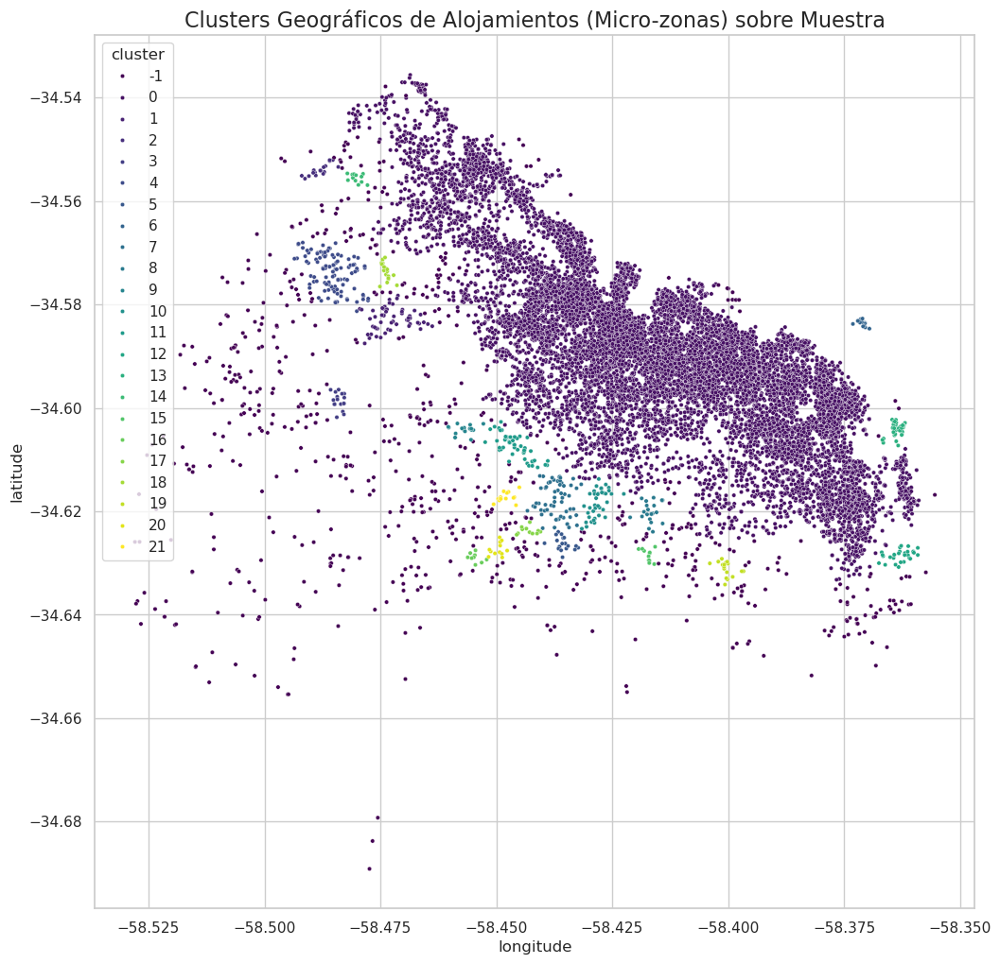


--- Perfil de las Micro-zonas Encontradas ---


,precio_mediano,sentiment_promedio,tasa_ocupacion_promedio,cantidad_alojamientos
cluster,,,,
13,111396.5,0.212968,0.375398,41
6,53262.0,0.135319,0.210649,17
18,47260.0,0.201718,0.513833,18
0,40958.0,0.196529,0.375773,13681
5,37740.0,0.126120,0.386936,19
7,36910.0,0.155401,0.477853,59
17,36758.0,0.184355,0.399928,11
4,36758.0,0.128992,0.372251,115
15,34720.5,0.254740,0.220028,12


In [81]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import numpy as np

# --- Solución: Usar una muestra de los datos ---
# Tomamos una muestra aleatoria de 15,000 puntos para evitar problemas de memoria.
# Este tamaño es suficiente para identificar los clusters principales.
df_sample_cluster = df.sample(n=15000, random_state=42)

# 1. Preparar los datos de coordenadas desde la MUESTRA
coords = df_sample_cluster[['latitude', 'longitude']].copy()
coords.dropna(inplace=True)

# 2. Escalar los datos
scaler = StandardScaler()
# Usamos np.radians para convertir grados a radianes para la métrica haversine
coords_scaled = scaler.fit_transform(np.radians(coords))

# 3. Aplicar el algoritmo DBSCAN
# Probamos con la métrica euclidiana sobre los datos escalados, que es más rápida.
# Si los resultados no son buenos, se puede volver a haversine.
dbscan = DBSCAN(eps=0.1, min_samples=10)
clusters = dbscan.fit_predict(coords_scaled)

# 4. Añadir las etiquetas de cluster al DataFrame de la muestra
coords['cluster'] = clusters
df_sample_cluster = df_sample_cluster.merge(coords[['cluster']], left_index=True, right_index=True)

# 5. Visualizar los clusters en un mapa
plt.figure(figsize=(12, 12))
sns.scatterplot(data=df_sample_cluster, x='longitude', y='latitude', hue='cluster', palette='viridis', s=10, legend='full')
plt.title('Clusters Geográficos de Alojamientos (Micro-zonas) sobre Muestra', fontsize=16)
plt.show()

# 6. Perfilar los clusters (excluyendo el ruido - cluster -1)
df_clusters_validos = df_sample_cluster[df_sample_cluster['cluster'] != -1]
perfil_clusters = df_clusters_validos.groupby('cluster').agg(
    precio_mediano=('price', 'median'),
    sentiment_promedio=('sentiment_score', 'mean'),
    tasa_ocupacion_promedio=('tasa_ocupacion_90d', 'mean'),
    cantidad_alojamientos=('id', 'count')
).sort_values(by='precio_mediano', ascending=False)

print("\n--- Perfil de las Micro-zonas Encontradas ---")
display(perfil_clusters)

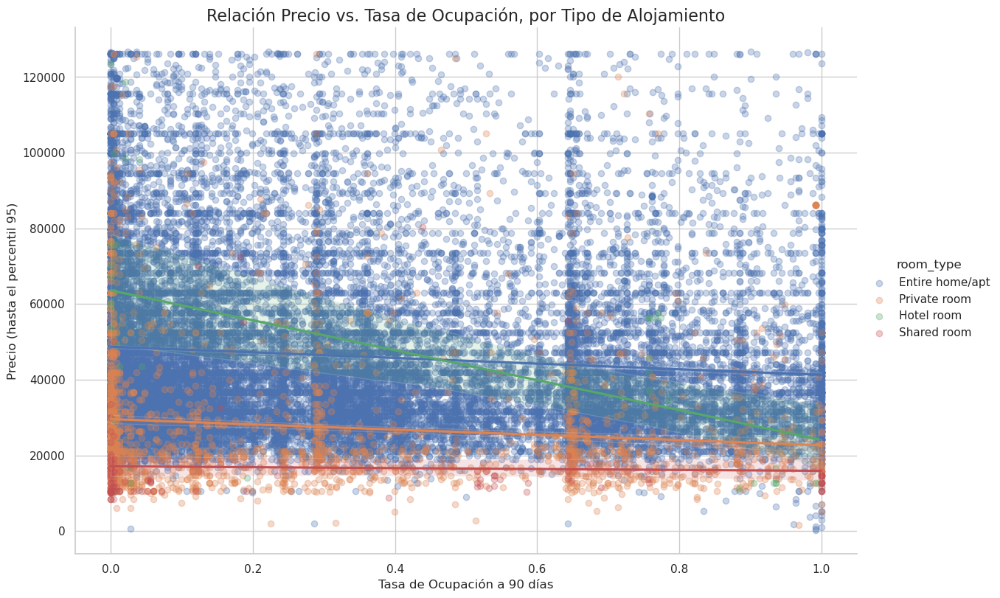

In [82]:
# Este código asume que 'df' ya tiene las columnas 'tasa_ocupacion_90d' y 'precio_promedio_calendario'
# y que los outliers de precio ya han sido filtrados en un df_filtered
price_limit = df['price'].quantile(0.95)
df_filtered = df[df['price'] < price_limit]


# Usamos lmplot para crear un scatter plot con líneas de regresión por categoría
# y lo segmentamos por 'room_type'.
sns.lmplot(data=df_filtered,
           x='tasa_ocupacion_90d',
           y='price',
           hue='room_type',
           height=8,
           aspect=1.5,
           scatter_kws={'alpha': 0.3})

plt.title('Relación Precio vs. Tasa de Ocupación, por Tipo de Alojamiento', fontsize=16)
plt.xlabel('Tasa de Ocupación a 90 días', fontsize=12)
plt.ylabel('Precio (hasta el percentil 95)', fontsize=12)
plt.show()

/tmp/ipykernel_7458/810196650.py:6: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  reviews_por_mes = df_reviews.set_index('date').resample('M').size()


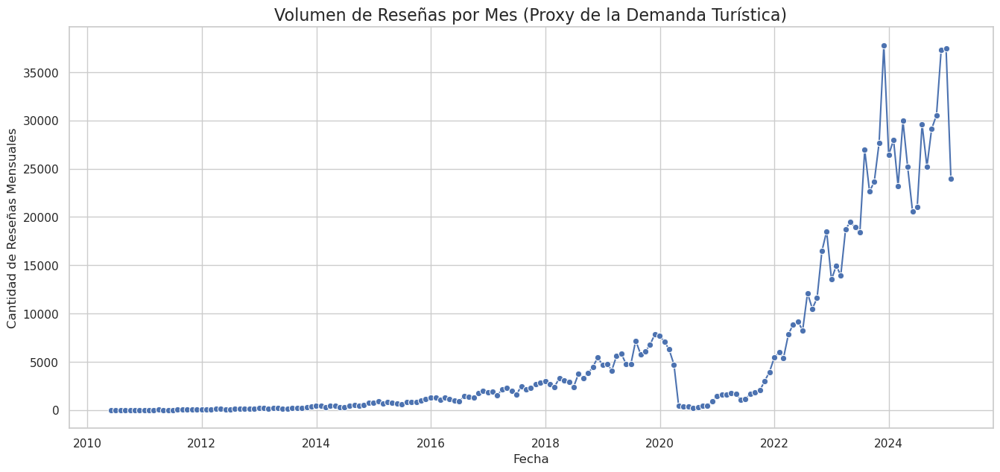

In [83]:
# Este código asume que 'df_reviews' está cargado
# 1. Asegurarse que la columna 'date' es de tipo datetime
df_reviews['date'] = pd.to_datetime(df_reviews['date'])

# 2. Agrupar el conteo de reseñas por mes
reviews_por_mes = df_reviews.set_index('date').resample('M').size()
reviews_por_mes = reviews_por_mes.reset_index(name='cantidad_reviews')
reviews_por_mes.rename(columns={'date': 'mes'}, inplace=True)


# 3. Graficar la serie de tiempo
plt.figure(figsize=(16, 7))
sns.lineplot(data=reviews_por_mes, x='mes', y='cantidad_reviews', marker='o')
plt.title('Volumen de Reseñas por Mes (Proxy de la Demanda Turística)', fontsize=16)
plt.xlabel('Fecha', fontsize=12)
plt.ylabel('Cantidad de Reseñas Mensuales', fontsize=12)
plt.show()

In [84]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder

# 1. Preparar los datos para el modelo
# Seleccionamos un subconjunto de características y filtramos outliers y nulos
features = ['neighbourhood', 'room_type', 'latitude', 'longitude']
target = 'price'
df_model = df[features + [target]].dropna()
price_limit = df_model['price'].quantile(0.95)
df_model = df_model[df_model['price'] < price_limit]

# 2. One-Hot Encoding para variables categóricas
X_cat = df_model[['neighbourhood', 'room_type']]
X_num = df_model[['latitude', 'longitude']]
encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
X_cat_encoded = encoder.fit_transform(X_cat)
X = np.concatenate([X_num.values, X_cat_encoded], axis=1)
y = df_model[target]

# 3. Entrenar un modelo de Regresión Lineal
model = LinearRegression()
model.fit(X, y)

# 4. Predecir y calcular los residuos
predicted_prices = model.predict(X)
residuals = df_model['price'] - predicted_prices

# 5. Añadir residuos al dataframe y encontrar las mayores anomalías
df_model['predicted_price'] = predicted_prices
df_model['residual'] = residuals

print("--- Top 5 Alojamientos 'Sobrevalorados' (Precio real > Predicción) ---")
display(df_model.sort_values(by='residual', ascending=False).head(5))

print("\n--- Top 5 Alojamientos 'Infravalorados' (Precio real < Predicción) ---")
display(df_model.sort_values(by='residual', ascending=True).head(5))

--- Top 5 Alojamientos 'Sobrevalorados' (Precio real > Predicción) ---


,neighbourhood,room_type,latitude,longitude,price,predicted_price,residual
34730,Monserrat,Private room,-34.609320,-58.375380,124976.0,26097.223171,98878.776829
28015,Barracas,Private room,-34.641220,-58.374300,126026.0,27744.853482,98281.146518
19025,Palermo,Private room,-34.589163,-58.431359,126026.0,31710.347253,94315.652747
9252,Palermo,Private room,-34.586350,-58.432680,125280.0,32232.204846,93047.795154
22968,Palermo,Private room,-34.582640,-58.413640,126026.0,36145.812455,89880.187545



--- Top 5 Alojamientos 'Infravalorados' (Precio real < Predicción) ---


,neighbourhood,room_type,latitude,longitude,price,predicted_price,residual
23127,Puerto Madero,Private room,-34.616819,-58.355403,18904.0,70028.693880,-51124.693880
29570,Puerto Madero,Entire home/apt,-34.621137,-58.365221,33008.0,83281.404085,-50273.404085
8147,Palermo,Entire home/apt,-34.566970,-58.435960,3800.0,52623.056832,-48823.056832
7033,Recoleta,Entire home/apt,-34.586010,-58.396990,2000.0,50048.647142,-48048.647142
7772,Recoleta,Entire home/apt,-34.588260,-58.394870,1999.0,49796.278955,-47797.278955


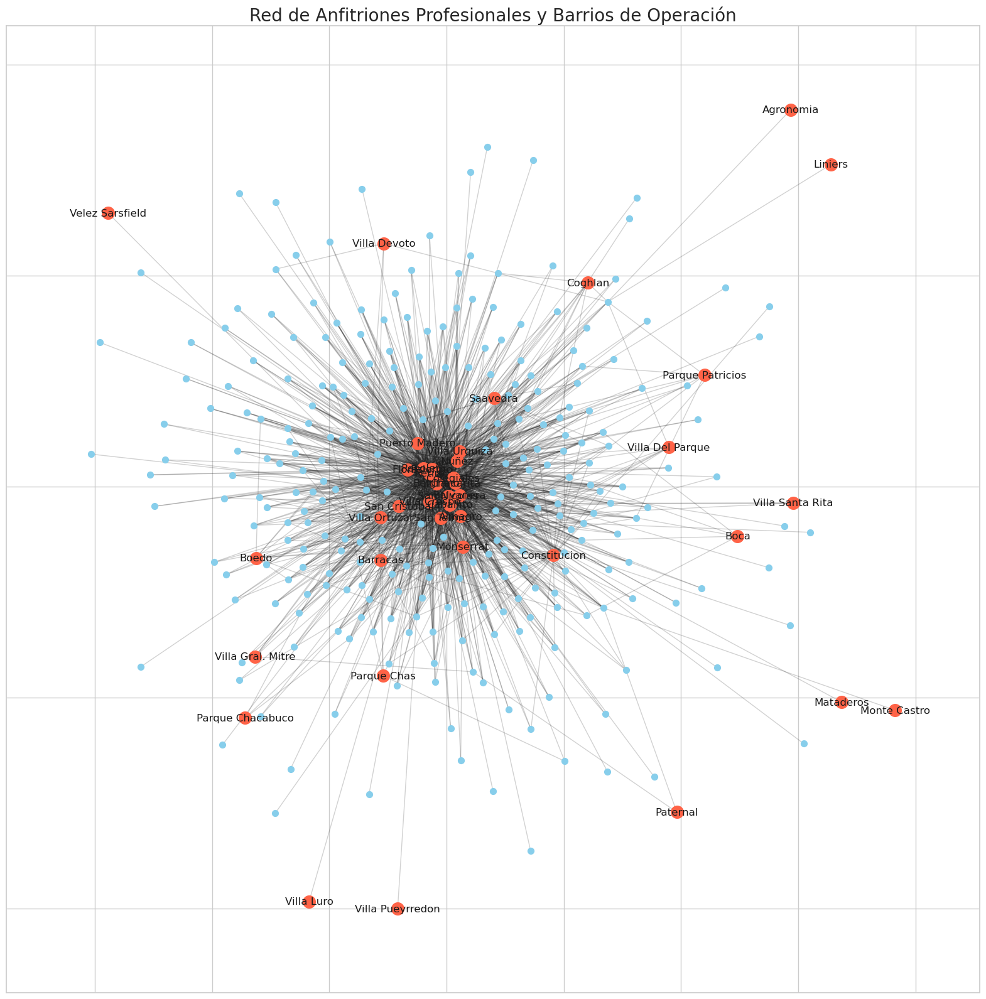

In [85]:
# Instalar networkx si no está presente
!pip install networkx -q
import networkx as nx

# 1. Preparar los datos: anfitriones con más de 10 propiedades y los barrios donde operan
df_prof_hosts = df[df['calculated_host_listings_count'] > 10]
host_barrio_edges = df_prof_hosts[['host_name', 'neighbourhood']].drop_duplicates()

# 2. Crear el grafo desde el dataframe de relaciones
G = nx.from_pandas_edgelist(host_barrio_edges, 'host_name', 'neighbourhood')

# 3. Visualizar el grafo
#    Nota: esta visualización puede ser densa y es mejor para análisis exploratorio.
plt.figure(figsize=(20, 20))

# Definir un layout
pos = nx.spring_layout(G, k=0.3, iterations=50)

# Dibujar nodos de anfitriones y barrios con diferentes colores y tamaños
nodos_anfitriones = set(host_barrio_edges['host_name'])
nodos_barrios = set(host_barrio_edges['neighbourhood'])

nx.draw_networkx_nodes(G, pos, nodelist=nodos_anfitriones, node_color='skyblue', node_size=50)
nx.draw_networkx_nodes(G, pos, nodelist=nodos_barrios, node_color='tomato', node_size=200)

nx.draw_networkx_edges(G, pos, alpha=0.2)

# Dibujar etiquetas solo para los nodos de barrios para no saturar el gráfico
labels = {node:node for node in nodos_barrios}
nx.draw_networkx_labels(G, pos, labels, font_size=12)

plt.title('Red de Anfitriones Profesionales y Barrios de Operación', fontsize=20)
plt.show()

## Plantear un posible problema de ML supervisado a partir de los datos elegidos.
* Describir el problema de clasificación o de regresión.
* Definir la variable target

Propuesta 1: Predicción de Precios de Alquiler

Basado en el Análisis Exploratorio de Datos (EDA) realizado, se ha obtenido un entendimiento profundo de las variables que componen el dataset y las relaciones que existen entre ellas. Se ha identificado que características como la ubicación (`neighbourhood`, `latitude`, `longitude`), el tipo de propiedad (`room_type`) y otras métricas como la cantidad de reseñas (`number_of_reviews`) tienen una fuerte influencia en el precio de los alojamientos.

A partir de esta comprensión, se plantea el siguiente problema de Machine Learning Supervisado.

1. Descripción del Problema: Regresión de Precios**

El problema a resolver será el de predecir el precio por noche de un alojamiento listado en la plataforma AirBnB para la Ciudad de Buenos Aires. El objetivo es construir un modelo que, a partir de un conjunto de características (features) de un alojamiento, pueda estimar con la mayor precisión posible su tarifa diaria.

Este es un problema de **regresión**, ya que la variable que se busca predecir (el precio) es un valor numérico y continuo. El modelo aprenderá de los datos históricos para encontrar patrones que le permitan realizar estimaciones sobre alojamientos nuevos o no vistos previamente.

Las variables predictoras (features) a utilizar incluirán, entre otras:

* Ubicación geográfica (`latitude`, `longitude`).
* Barrio (`neighbourhood`).
* Tipo de alojamiento (`room_type`).
* Número de reseñas (`number_of_reviews`).
* Disponibilidad anual (`availability_365`).

2. Definición de la Variable Target**

La variable target (o variable objetivo) para este problema de regresión es la columna **`price`** del dataset.

* **Descripción:** `price` es una variable numérica continua que representa el costo por noche del alojamiento en la moneda local.
* **Características Notables:** Como se observó en el EDA, esta variable presenta un fuerte sesgo positivo y la existencia de numerosos valores atípicos (outliers). Estas características deberán ser gestionadas adecuadamente en la etapa de preprocesamiento (por ejemplo, mediante una transformación logarítmica) para optimizar el rendimiento del modelo.

---

 **Propuesta 2: Clasificación de Alojamientos de "Alta Tracción"**

Basado en el Análisis Exploratorio de Datos (EDA) realizado, se ha observado que no todos los alojamientos generan el mismo nivel de interés o volumen de reservas. Métricas como la cantidad de reseñas por mes (`reviews_per_month`) son un fuerte indicador de la "tracción" o popularidad de un listado. Se intuye que factores como el precio inicial, la disponibilidad y el tipo de propiedad pueden influir en que un alojamiento despegue rápidamente.

A partir de esta comprensión, se plantea el siguiente problema de Machine Learning Supervisado.

1. Descripción del Problema: Clasificación de Popularidad**

El problema a resolver será el de clasificar si un alojamiento puede ser considerado de "Alta Tracción". El objetivo es construir un modelo que, a partir de las características iniciales de un listado, pueda predecir si este logrará generar un alto volumen de reseñas, lo cual es un proxy de una alta tasa de ocupación.

Este es un problema de **clasificación binaria**, donde el modelo predecirá una de dos categorías: `1` (Alta Tracción) o `0` (Tracción Normal). Este modelo sería útil para la plataforma para identificar y promocionar listados prometedores, o para aconsejar a nuevos anfitriones sobre las mejores estrategias para ganar visibilidad.

Las variables predictoras (features) a utilizar incluirán, entre otras:

* Precio (`price`).
* Tipo de alojamiento (`room_type`).
* Disponibilidad anual (`availability_365`).
* Número mínimo de noches (`minimum_nights`).
* Barrio (`neighbourhood`).

**2. Definición de la Variable Target**

La variable target deberá ser creada mediante ingeniería de características a partir de la columna `reviews_per_month`. La llamaremos **`es_alta_traccion`**.

* Descripción:** `es_alta_traccion` es una variable binaria (`1` o `0`) que indica si un alojamiento recibe un número de reseñas por mes superior a un umbral definido.
* **Características Notables:** Para crearla, se debe establecer un umbral. Por ejemplo, se podría definir que un alojamiento es de "Alta Tracción" si su `reviews_per_month` es mayor al percentil 70 del dataset (o un valor fijo, como `> 1.0`). La elección de este umbral es una decisión clave del proyecto.

---

**Propuesta 3: Predicción de la Tasa de Ocupación**

Basado en el Análisis Exploratorio de Datos (EDA) realizado, se comprende que el precio es solo una faceta del éxito de un alojamiento. Otra métrica fundamental es su capacidad para mantenerse ocupado. La variable `availability_365` nos da una visión directa de cuántos días al año una propiedad no está reservada, permitiéndonos inferir su nivel de ocupación y analizar qué características la impulsan.

A partir de esta comprensión, se plantea el siguiente problema de Machine Learning Supervisado.

**1. Descripción del Problema: Regresión de Ocupación**

El problema a resolver será el de predecir el número de días que un alojamiento estará reservado durante un año. El objetivo es construir un modelo que ayude a los anfitriones a entender qué combinación de características (precio, ubicación, políticas de reserva) maximiza la ocupación.

Este es un problema de **regresión**, ya que la variable a predecir (días reservados) es un valor numérico que puede ir de 0 a 365. El modelo permitiría a un anfitrión simular cómo cambios en su listado (ej. bajar el precio, reducir el mínimo de noches) podrían impactar en su tasa de ocupación anual.

Las variables predictoras (features) a utilizar incluirán, entre otras:

* Precio (`price`).
* Ubicación geográfica (`latitude`, `longitude`).
* Tipo de alojamiento (`room_type`).
* Número de reseñas (`number_of_reviews`).
* Número mínimo de noches (`minimum_nights`).

**2. Definición de la Variable Target**

La variable target, que llamaremos **`dias_reservados_anuales`**, se debe crear a partir de la columna `availability_365`.

* **Descripción:** `dias_reservados_anuales` es una variable numérica que representa el total de días en un año que una propiedad ha estado ocupada. Se calcula con la fórmula: `365 - availability_365`.
* **Características Notables:** Esta variable estará acotada entre 0 y 365. Su distribución puede estar sesgada hacia los extremos (propiedades con muy baja o muy alta ocupación), lo cual deberá ser analizado durante el preprocesamiento.

---

**Propuesta 4: Clasificación por Modalidad de Estancia (Corta vs. Larga)**

Basado en el Análisis Exploratorio de Datos (EDA) realizado, se observa que la variable `minimum_nights` (número mínimo de noches) varía significativamente entre los alojamientos. Esto sugiere que los anfitriones optimizan sus propiedades para distintos tipos de viajeros: algunos buscan turistas de fin de semana (estancias cortas), mientras que otros prefieren nómadas digitales o estudiantes (estancias largas).

A partir de esta comprensión, se plantea el siguiente problema de Machine Learning Supervisado.

**1. Descripción del Problema: Clasificación de Modalidad de Estancia**

El problema a resolver será clasificar si un alojamiento está orientado a "Estancias Cortas" o "Estancias Largas". El objetivo es construir un modelo que pueda inferir la modalidad preferida de un alojamiento basándose en sus características, sin mirar directamente su política de `minimum_nights`.

Este es un problema de **clasificación binaria**. Un modelo de este tipo podría ayudar a la plataforma a segmentar su inventario y crear filtros de búsqueda más inteligentes, o a aconsejar a los anfitriones sobre qué tipo de mercado se alinea mejor con las características de su propiedad.

Las variables predictoras (features) a utilizar incluirán, entre otras:

* Precio (`price`).
* Tipo de alojamiento (`room_type`).
* Barrio (`neighbourhood`).
* Disponibilidad anual (`availability_365`).
* Número de reseñas por mes (`reviews_per_month`).

**2. Definición de la Variable Target**

La variable target será creada a partir de la columna `minimum_nights` y la llamaremos **`es_estancia_corta`**.

* **Descripción:** `es_estancia_corta` es una variable binaria (`1` o `0`). Se le asignará el valor `1` si el alojamiento está orientado a estancias cortas y `0` si está orientado a estancias largas.
* **Características Notables:** La creación de esta variable depende de un umbral. Por ejemplo, podríamos definir que una "Estancia Corta" es aquella donde `minimum_nights` es menor o igual a 3 días. Todos los alojamientos que cumplan esta condición tendrán `es_estancia_corta = 1`, y el resto `0`. La justificación y elección de este umbral es parte fundamental del planteamiento del problema.